<a href="https://colab.research.google.com/github/Klaterrr/CryptoCWT/blob/main/CryptoCWT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Data understanding and clening.**

# Downloading Dataset.

In [1]:
!mkdir ~/data
!curl -L -o ~/cryptocurrencypricehistory.zip\
  https://www.kaggle.com/api/v1/datasets/download/sudalairajkumar/cryptocurrencypricehistory
!unzip ~/cryptocurrencypricehistory.zip -d ~/data

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 1740k  100 1740k    0     0  2953k      0 --:--:-- --:--:-- --:--:-- 2953k
Archive:  /root/cryptocurrencypricehistory.zip
  inflating: /root/data/coin_Aave.csv  
  inflating: /root/data/coin_BinanceCoin.csv  
  inflating: /root/data/coin_Bitcoin.csv  
  inflating: /root/data/coin_Cardano.csv  
  inflating: /root/data/coin_ChainLink.csv  
  inflating: /root/data/coin_Cosmos.csv  
  inflating: /root/data/coin_CryptocomCoin.csv  
  inflating: /root/data/coin_Dogecoin.csv  
  inflating: /root/data/coin_EOS.csv  
  inflating: /root/data/coin_Ethereum.csv  
  inflating: /root/data/coin_Iota.csv  
  inflating: /root/data/coin_Litecoin.csv  
  inflating: /root/data/coin_Monero.csv  
  inflating: /root/data/coin_NEM.csv  
  inflating: /root/data/coin_Polkado

# Installing libraries.
You might need to install numpy/pandas/yfinance/matplotlib/statsmodels as well (google colab is already have all that).

In [2]:
!pip install PyWavelets matplotlib oct2py piwavelet # numpy pandas yfinance matplotlib statsmodels

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 531.8/531.8 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 217.8/217.8 kB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 16.4 MB/s eta 0:00:00


In [3]:
import pywt
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import matplotlib.dates as mdates  # Для работы с датами на графиках

from datetime import datetime
from statsmodels.tsa.stattools import acf, pacf

# **Loading and cleaning the data**

In [4]:
"""
Загружает и очищает данные о криптовалютах с Yahoo Finance.

Args:
    tickers (list): Список тикеров криптовалют (например, ['BTC-USD', 'ETH-USD']).
    start_date (str): Начальная дата в формате 'YYYY-MM-DD'.
    end_date (str): Конечная дата в формате 'YYYY-MM-DD'.

Returns:
    dict: Словарь, где ключи - тикеры, а значения - DataFrame с очищенными данными.
        Если данные для тикера не удалось загрузить, значение будет None.
"""
def load_and_clean_data(tickers, start_date, end_date):
    data = {}
    for ticker in tickers:
        try:
            # Загрузка данных с yfinance
            df = yf.download(ticker, start=start_date, end=end_date)

            print(f"Type of df for {ticker}: {type(df)}") # Debugging print
            print(f"df.head() for {ticker}:\n{df.head()}") # Debugging print
            print(f"df.columns for {ticker}: {df.columns}") # NEW: Print column names

            if df is None:  # Check if df is None after download
                print(f"Ошибка: yf.download вернул None для {ticker}. Возможно, тикер неверный или проблема с yfinance/Yahoo Finance.")
                data[ticker] = None
                continue

            # Проверка на наличие данных
            if df.empty:
                print(f"Данные для {ticker} не найдены.")
                data[ticker] = None
                continue

            # Проверка типов данных и преобразование при необходимости
            for col in ['Open', 'High', 'Low', 'Close', 'Volume', 'Adj Close']:
                try: # Added try-except inside the loop
                    print(f"Trying df[('{col}', '{ticker}')].iloc[0] for {ticker}: {df[(col, ticker)].iloc[0]}") # NEW: Try iloc before dtype
                    print(f"Trying df[('{col}', '{ticker}')].name for {ticker}: {df[(col, ticker)].name}")       # NEW: Try .name before dtype
                    if df[(col, ticker)].dtype == 'object':  # If suddenly a string
                        try:
                            df[(col, ticker)] = pd.to_numeric(df[(col, ticker)], errors='coerce') # errors='coerce' заменит нечисловые значения на NaN
                        except ValueError:
                            print(f"ValueError при преобразовании данных в числовой формат для {ticker}, столбец {col}.")
                            data[ticker] = None  # Или другое действие по обработке ошибки
                            continue
                except AttributeError as e: # Catch AttributeError if df[col] doesn't behave like a Series
                    print(f"AttributeError при обработке столбца {col} для {ticker}: {e}")
                    data[ticker] = None
                    continue
                except KeyError as e: # Catch KeyError if column doesn't exist
                    print(f"KeyError при обработке столбца {col} для {ticker}: {e}")
                    data[ticker] = None
                    continue


            # Обработка пропущенных значений (NaN)
            df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением
            df.dropna(inplace=True) # Удаление оставшихся строк с NaN (если есть в начале)

            data[ticker] = df

        except Exception as e:
            print(f"Ошибка при загрузке данных для {ticker}: {e}")
            data[ticker] = None

    return data


# Lonely visualizing functions

In [5]:
def visualize_data(data):
    """
    Визуализирует данные о криптовалютах.

    Args:
        data (dict): Словарь, возвращаемый функцией load_and_clean_data.
    """

    for ticker, df in data.items():
        if df is not None:
            # Создание фигуры и набора осей
            fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 8), sharex=True)

            # График цен (Close)
            axes[0].plot(df.index, df[('Close', ticker)], label=f'{ticker} Close Price', color='blue') # Access 'Close' with ticker
            axes[0].set_title(f'{ticker} - Close Price and Volume')
            axes[0].set_ylabel('Price (USD)')
            axes[0].grid(True)
            axes[0].legend()

             # Установка формата даты на оси X
            axes[0].xaxis.set_major_locator(mdates.AutoDateLocator())  # Автоматический выбор расположения меток
            axes[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d')) # Формат даты
            fig.autofmt_xdate() # Наклон меток для лучшей читаемости


            # График объема торгов
            axes[1].bar(df.index, df[('Volume', ticker)], label=f'{ticker} Volume', color='gray', alpha=0.7, linewidth=0) # Access 'Volume' with ticker and set linewidth=0
            axes[1].set_ylabel('Volume')
            axes[1].grid(True)
            axes[1].legend()

            # Установка формата даты на оси X
            axes[1].xaxis.set_major_locator(mdates.AutoDateLocator())
            axes[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))

            # График логарифма цены (Close) - добавляем, как обсуждали
            plt.figure(figsize=(14, 4))  # Отдельный график для логарифма
            plt.plot(df.index, np.log(df[('Close', ticker)]), label=f'{ticker} Log(Close Price)', color='green') # Access 'Close' with ticker
            plt.title(f'{ticker} - Logarithm of Close Price')
            plt.ylabel('Log(Price)')
            plt.grid(True)
            plt.legend()
            plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator()) # Авто-локатор
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))  # Формат
            plt.gcf().autofmt_xdate() # Наклон

            # Отображение графиков
            plt.tight_layout()  # Чтобы графики не перекрывались
            plt.show()

In [6]:
def decompose_timeseries(data, window_size=30):
    """
    Выполняет первичную декомпозицию временных рядов с использованием скользящего среднего.

    Args:
        data (dict): Словарь, возвращаемый функцией load_and_clean_data.
        window_size (int): Размер окна для скользящего среднего.

    Returns:
        dict: Словарь, содержащий исходные данные, тренд, остатки, ACF и PACF остатков.
    """

    decomposed_data = {}

    for ticker, df in data.items():
        if df is not None:
            # Рассчитываем скользящее среднее (тренд)
            df['MA'] = df[('Close', ticker)].rolling(window=window_size, center=True).mean() # Access 'Close' with ticker

            # Рассчитываем остатки (колебательная компонента)
            df['Residuals'] = df[('Close', ticker)] - df['MA'] # Access 'Close' with ticker

            # Удаляем NaN, появившиеся из-за скользящего среднего (по краям ряда)
            df_clean = df.dropna()  # Важно!  Иначе acf/pacf не будут работать

            # Рассчитываем ACF и PACF для остатков
            lags = min(len(df_clean) // 2 - 1, 40) #кол-во лагов, но не больше половины длины и не больше 40
            acf_values = acf(df_clean['Residuals'], nlags=lags)
            pacf_values = pacf(df_clean['Residuals'], nlags=lags)

            decomposed_data[ticker] = {
                'original': df,  # Исходный DataFrame с MA и Residuals
                'trend': df_clean['MA'],
                'residuals': df_clean['Residuals'],
                'acf': acf_values,
                'pacf': pacf_values
            }
    return decomposed_data


def visualize_decomposition(decomposed_data):
    """Визуализирует результаты декомпозиции."""
    for ticker, data in decomposed_data.items():
      if data is not None:
        df = data['original']

        fig, axes = plt.subplots(4, 1, figsize=(14, 12), sharex=True)

        # 1. Исходный ряд и тренд
        axes[0].plot(df.index, df[('Close', ticker)], label='Original', color='blue') # Access 'Close' with ticker
        axes[0].plot(df.index, df['MA'], label=f'MA ({df["MA"].notna().sum()})', color='red') #label с указанием количества значений
        axes[0].set_title(f'{ticker} - Original Series and Moving Average (Trend)')
        axes[0].set_ylabel('Price (USD)')
        axes[0].grid(True)
        axes[0].legend()
        axes[0].xaxis.set_major_locator(mdates.AutoDateLocator())
        axes[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))


        # 2. Остатки
        axes[1].plot(df.index, df['Residuals'], label='Residuals', color='green')
        axes[1].set_title(f'{ticker} - Residuals')
        axes[1].set_ylabel('Residuals')
        axes[1].grid(True)
        axes[1].legend()
        axes[1].xaxis.set_major_locator(mdates.AutoDateLocator())
        axes[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))

        # 3. ACF остатков
        axes[2].stem(np.arange(len(data['acf'])), data['acf'], markerfmt=" ", basefmt="-b") #Изменения тут
        axes[2].set_title(f'{ticker} - Autocorrelation Function (ACF) of Residuals')
        axes[2].set_xlabel('Lag')
        axes[2].set_ylabel('ACF')
        axes[2].grid(True)
        axes[2].axhline(y=0, color='k', linestyle='--') # Добавим линию 0
        axes[2].axhline(y=-1.96/np.sqrt(len(df['Residuals'].dropna())), color='gray', linestyle='--') # Добавим дов. интервалы
        axes[2].axhline(y=1.96/np.sqrt(len(df['Residuals'].dropna())), color='gray', linestyle='--')

        # 4. PACF остатков
        axes[3].stem(np.arange(len(data['pacf'])), data['pacf'], markerfmt=" ", basefmt="-b") #Изменения тут
        axes[3].set_title(f'{ticker} - Partial Autocorrelation Function (PACF) of Residuals')
        axes[3].set_xlabel('Lag')
        axes[3].set_ylabel('PACF')
        axes[3].grid(True)
        axes[3].axhline(y=0, color='k', linestyle='--') # Добавим линию 0
        axes[3].axhline(y=-1.96/np.sqrt(len(df['Residuals'].dropna())), color='gray', linestyle='--') # Добавим дов. интервалы
        axes[3].axhline(y=1.96/np.sqrt(len(df['Residuals'].dropna())), color='gray', linestyle='--')


        fig.autofmt_xdate()
        plt.tight_layout()
        plt.show()

YF.download() has changed argument auto_adjust default to True


[*********************100%***********************]  1 of 1 completed
<ipython-input-4-1238d1038dfb>:58: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением


Type of df for BTC-USD: <class 'pandas.core.frame.DataFrame'>
df.head() for BTC-USD:
Price             Close         High          Low         Open       Volume
Ticker          BTC-USD      BTC-USD      BTC-USD      BTC-USD      BTC-USD
Date                                                                       
2020-01-01  7200.174316  7254.330566  7174.944336  7194.892090  18565664997
2020-01-02  6985.470215  7212.155273  6935.270020  7202.551270  20802083465
2020-01-03  7344.884277  7413.715332  6914.996094  6984.428711  28111481032
2020-01-04  7410.656738  7427.385742  7309.514160  7345.375488  18444271275
2020-01-05  7411.317383  7544.497070  7400.535645  7410.451660  19725074095
df.columns for BTC-USD: MultiIndex([( 'Close', 'BTC-USD'),
            (  'High', 'BTC-USD'),
            (   'Low', 'BTC-USD'),
            (  'Open', 'BTC-USD'),
            ('Volume', 'BTC-USD')],
           names=['Price', 'Ticker'])
Trying df[('Open', 'BTC-USD')].iloc[0] for BTC-USD: 7194.89208984375


[*********************100%***********************]  1 of 1 completed
<ipython-input-4-1238d1038dfb>:58: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением


Type of df for ETH-USD: <class 'pandas.core.frame.DataFrame'>
df.head() for ETH-USD:
Price            Close        High         Low        Open       Volume
Ticker         ETH-USD     ETH-USD     ETH-USD     ETH-USD      ETH-USD
Date                                                                   
2020-01-01  130.802002  132.835358  129.198288  129.630661   7935230330
2020-01-02  127.410179  130.820038  126.954910  130.820038   8032709256
2020-01-03  134.171707  134.554016  126.490021  127.411263  10476845358
2020-01-04  135.069366  136.052719  133.040558  134.168518   7430904515
2020-01-05  136.276779  139.410202  135.045624  135.072098   7526675353
df.columns for ETH-USD: MultiIndex([( 'Close', 'ETH-USD'),
            (  'High', 'ETH-USD'),
            (   'Low', 'ETH-USD'),
            (  'Open', 'ETH-USD'),
            ('Volume', 'ETH-USD')],
           names=['Price', 'Ticker'])
Trying df[('Open', 'ETH-USD')].iloc[0] for ETH-USD: 129.6306610107422
Trying df[('Open', 'ETH-USD')].

[*********************100%***********************]  1 of 1 completed
<ipython-input-4-1238d1038dfb>:58: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением


Type of df for ADA-USD: <class 'pandas.core.frame.DataFrame'>
df.head() for ADA-USD:
Price          Close      High       Low      Open    Volume
Ticker       ADA-USD   ADA-USD   ADA-USD   ADA-USD   ADA-USD
Date                                                        
2020-01-01  0.033458  0.033813  0.032704  0.032832  22948374
2020-01-02  0.032751  0.033507  0.032448  0.033474  20843934
2020-01-03  0.034180  0.034427  0.032491  0.032748  30162644
2020-01-04  0.034595  0.034685  0.033872  0.034191  29535781
2020-01-05  0.034721  0.035356  0.034545  0.034574  21479178
df.columns for ADA-USD: MultiIndex([( 'Close', 'ADA-USD'),
            (  'High', 'ADA-USD'),
            (   'Low', 'ADA-USD'),
            (  'Open', 'ADA-USD'),
            ('Volume', 'ADA-USD')],
           names=['Price', 'Ticker'])
Trying df[('Open', 'ADA-USD')].iloc[0] for ADA-USD: 0.03283200040459633
Trying df[('Open', 'ADA-USD')].name for ADA-USD: ('Open', 'ADA-USD')
Trying df[('High', 'ADA-USD')].iloc[0] for ADA-U

[*********************100%***********************]  1 of 1 completed
<ipython-input-4-1238d1038dfb>:58: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением
[*********************100%***********************]  1 of 1 completed


Type of df for DOT-USD: <class 'pandas.core.frame.DataFrame'>
df.head() for DOT-USD:
Price          Close      High       Low      Open     Volume
Ticker       DOT-USD   DOT-USD   DOT-USD   DOT-USD    DOT-USD
Date                                                         
2020-08-20  2.900080  3.077784  2.692896  2.787857   48819867
2020-08-21  2.875028  3.090093  2.730919  2.896923   49313137
2020-08-22  4.484690  4.510613  2.816762  2.878570  485801096
2020-08-23  3.967066  4.487058  3.716271  4.487058  320749483
2020-08-24  4.602614  4.783158  3.812670  3.987413  407690171
df.columns for DOT-USD: MultiIndex([( 'Close', 'DOT-USD'),
            (  'High', 'DOT-USD'),
            (   'Low', 'DOT-USD'),
            (  'Open', 'DOT-USD'),
            ('Volume', 'DOT-USD')],
           names=['Price', 'Ticker'])
Trying df[('Open', 'DOT-USD')].iloc[0] for DOT-USD: 2.7878570556640625
Trying df[('Open', 'DOT-USD')].name for DOT-USD: ('Open', 'DOT-USD')
Trying df[('High', 'DOT-USD')].iloc[0] fo

<ipython-input-4-1238d1038dfb>:58: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением


Type of df for BNB-USD: <class 'pandas.core.frame.DataFrame'>
df.head() for BNB-USD:
Price           Close       High        Low       Open     Volume
Ticker        BNB-USD    BNB-USD    BNB-USD    BNB-USD    BNB-USD
Date                                                             
2020-01-01  13.689083  13.873946  13.654942  13.730962  172980718
2020-01-02  13.027011  13.715548  12.989974  13.698126  156376427
2020-01-03  13.660452  13.763709  13.012638  13.035329  173683857
2020-01-04  13.891512  13.921914  13.560008  13.667442  182230374
2020-01-05  14.111019  14.410801  13.886547  13.888340  202552703
df.columns for BNB-USD: MultiIndex([( 'Close', 'BNB-USD'),
            (  'High', 'BNB-USD'),
            (   'Low', 'BNB-USD'),
            (  'Open', 'BNB-USD'),
            ('Volume', 'BNB-USD')],
           names=['Price', 'Ticker'])
Trying df[('Open', 'BNB-USD')].iloc[0] for BNB-USD: 13.730961799621582
Trying df[('Open', 'BNB-USD')].name for BNB-USD: ('Open', 'BNB-USD')
Trying df

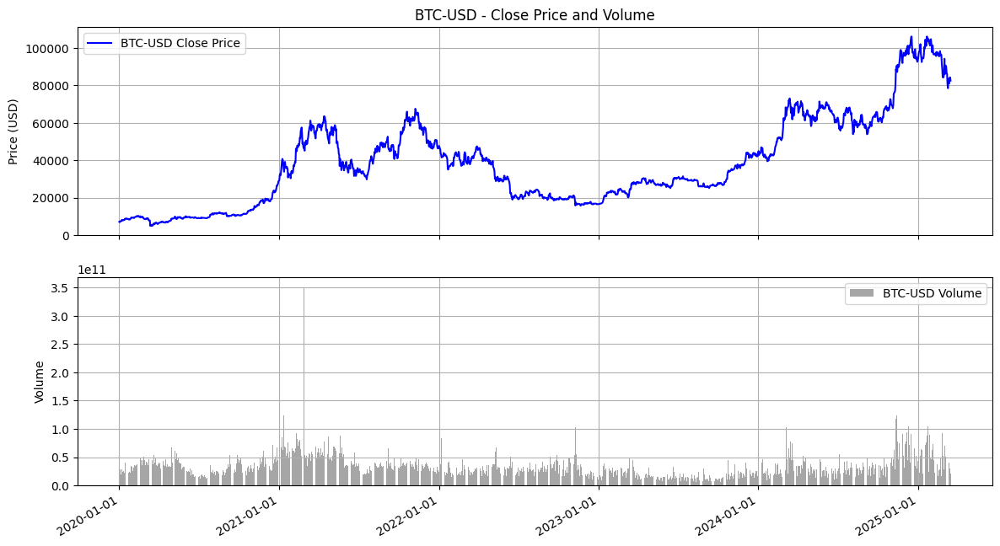

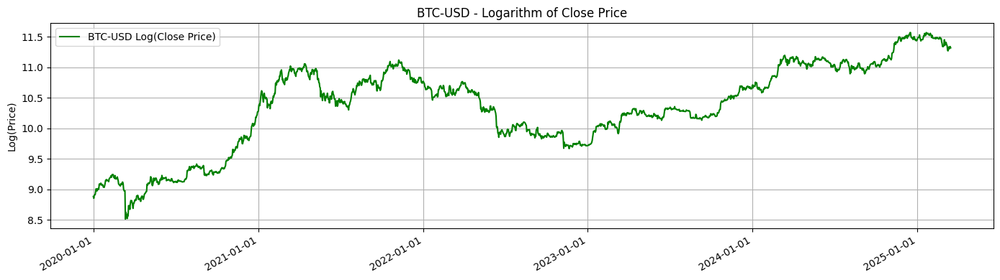

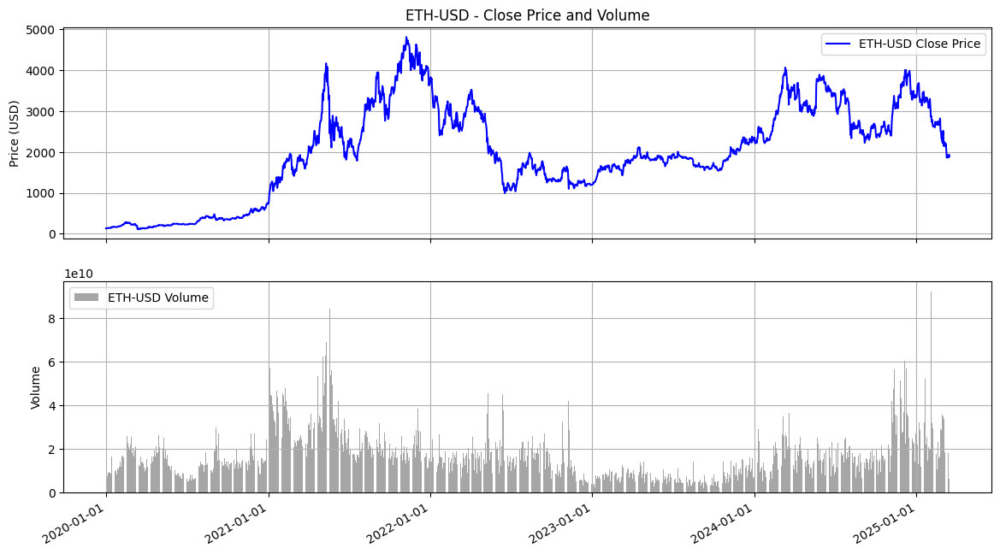

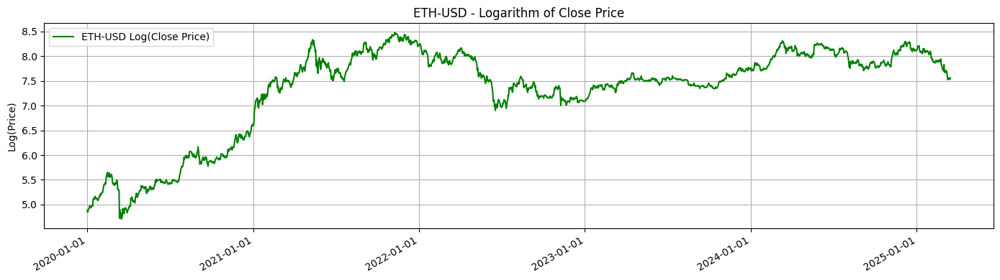

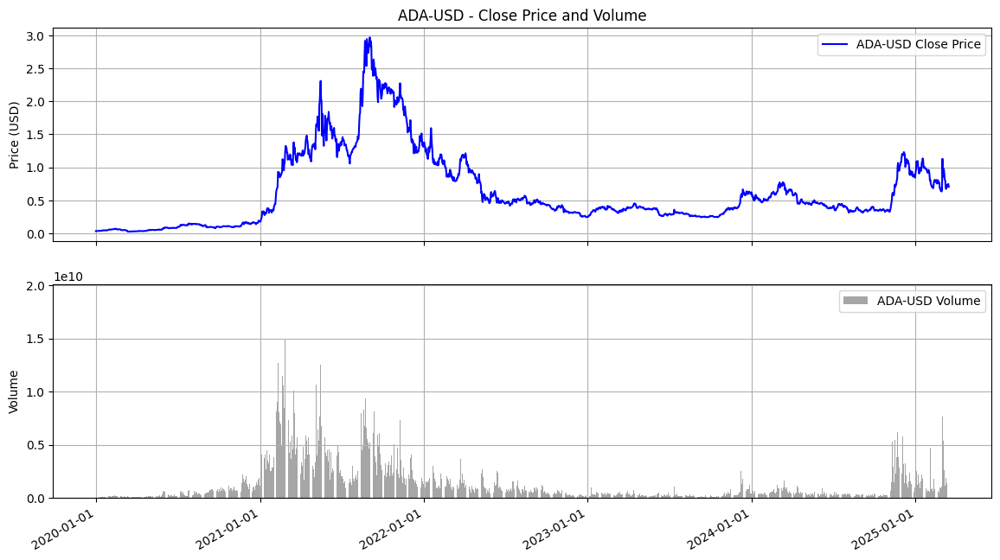

...

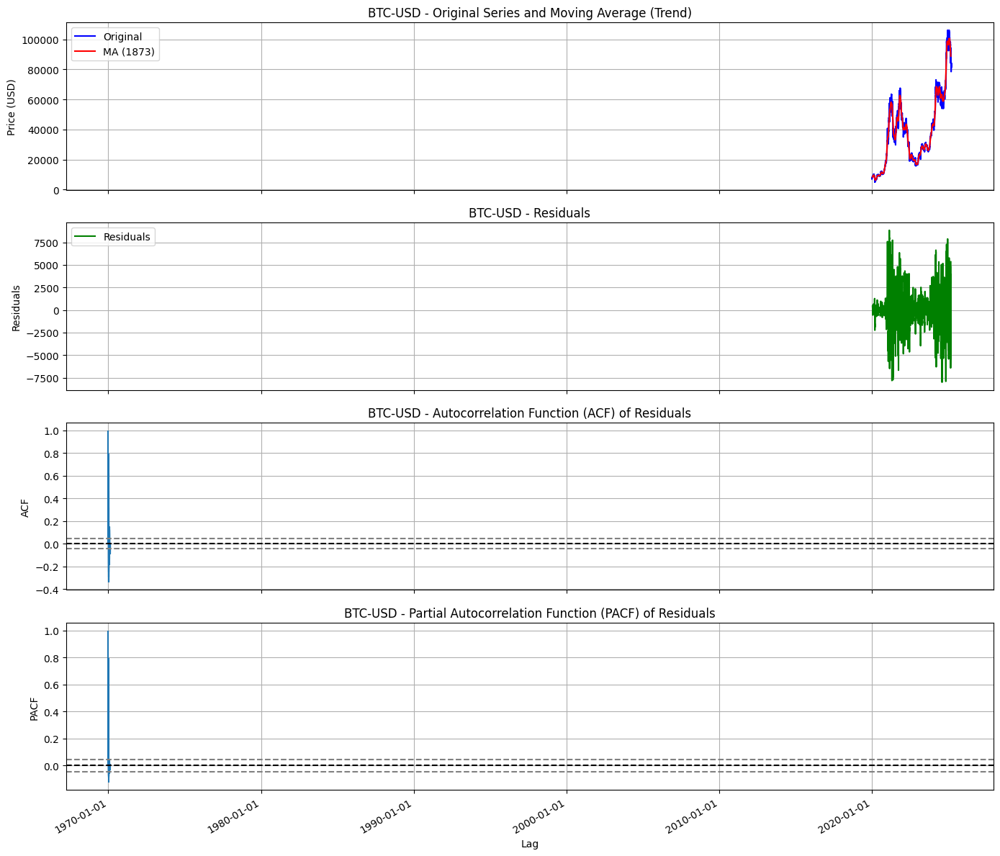

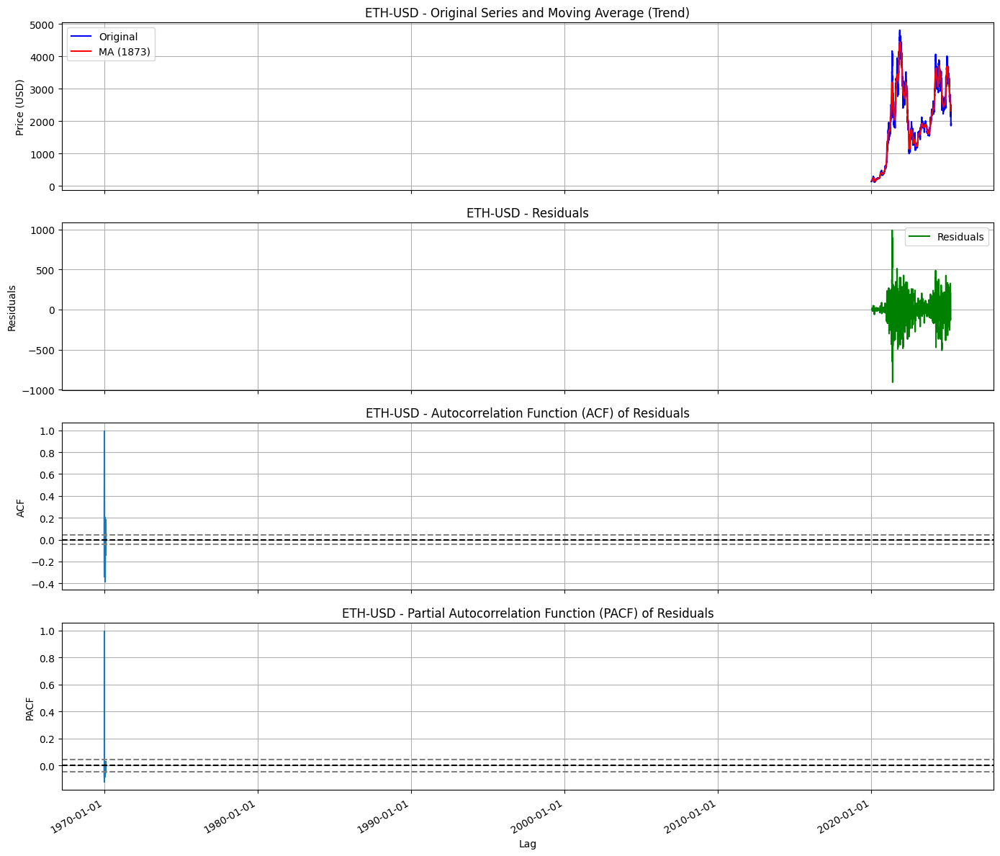

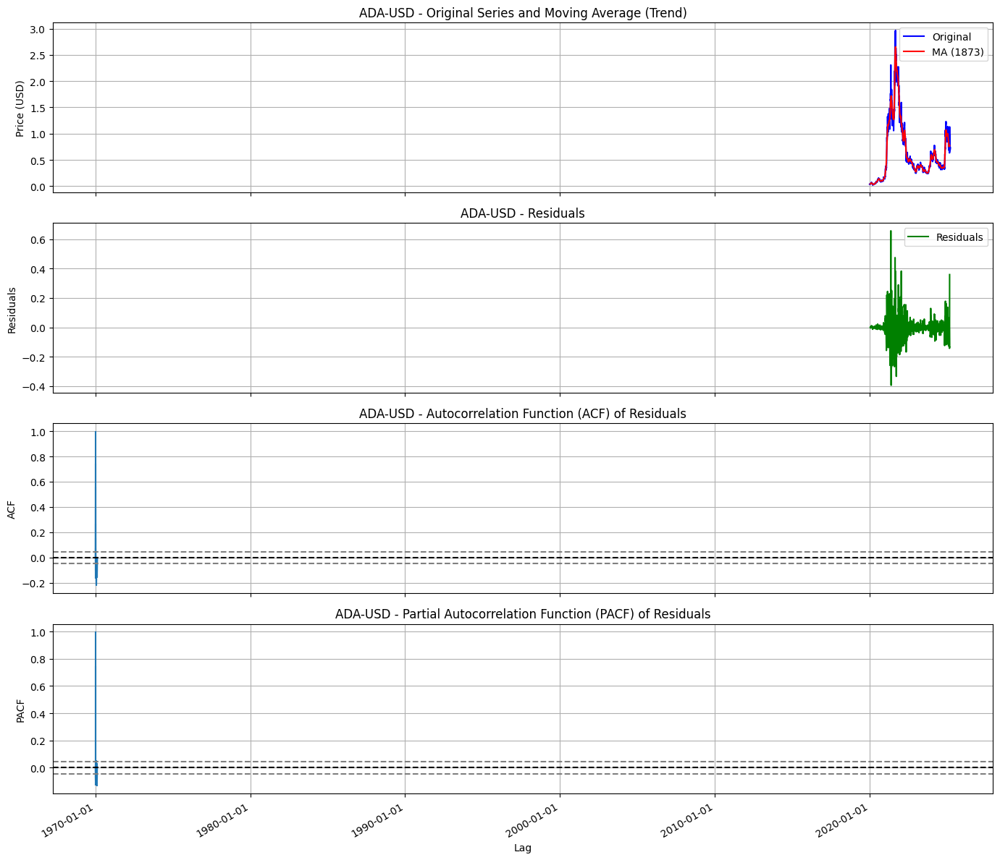

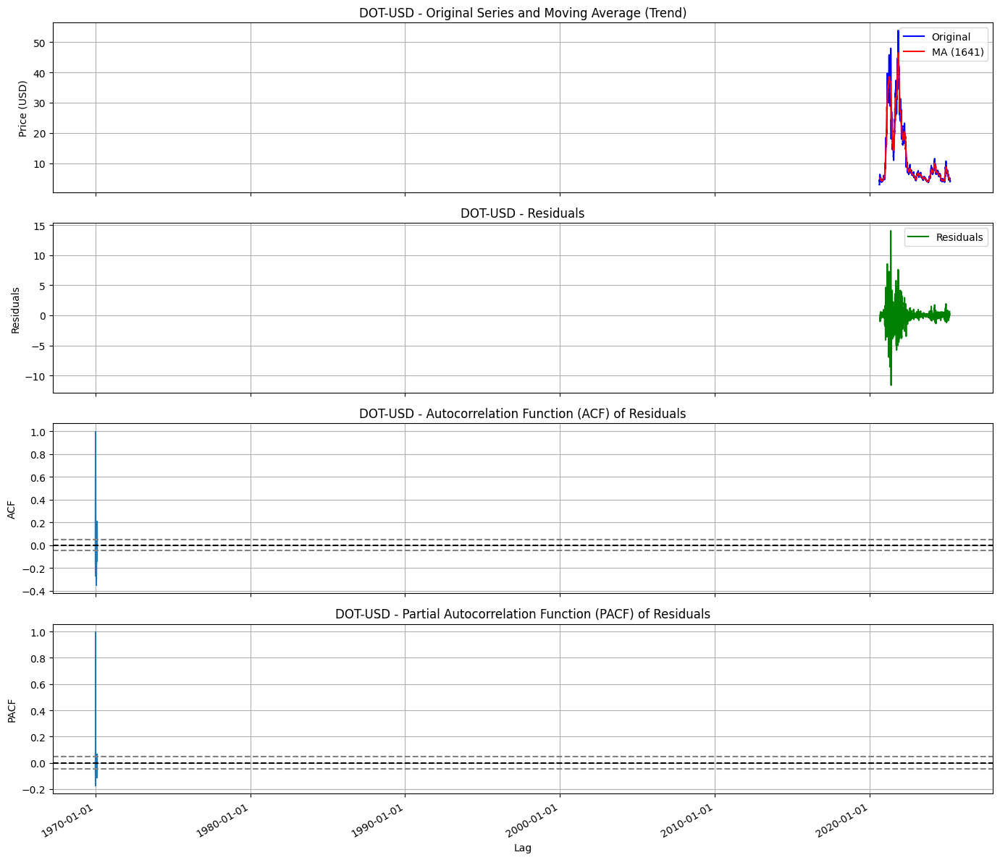

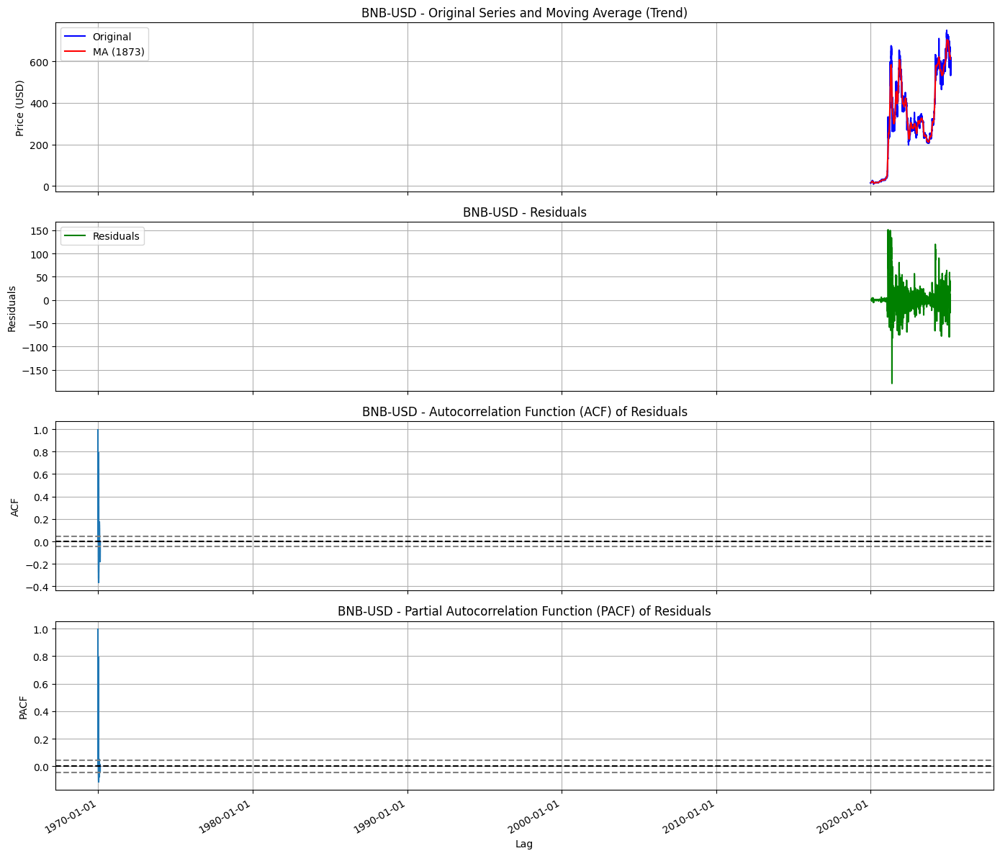

In [7]:
tickers = ['BTC-USD', 'ETH-USD', 'ADA-USD', 'DOT-USD', 'BNB-USD']
start_date = '2020-01-01'
end_date = datetime.today().strftime('%Y-%m-%d')

crypto_data = load_and_clean_data(tickers, start_date, end_date)

# Вывод информации о загруженных данных
for ticker, df in crypto_data.items():
    if df is not None:
        print(f"\nДанные для {ticker}:")
        print(df.head())
        print(df.info())
        print(df.describe()) # Основные статистики
    else:
        print(f"\nДанные {ticker} не удалось загрузить и обработать.")

# Визуализация данных
visualize_data(crypto_data)

# Декомпозиция временных рядов
decomposed_crypto_data = decompose_timeseries(crypto_data, window_size=30)

# Визуализация результатов декомпозиции
visualize_decomposition(decomposed_crypto_data)

# **Analysis itself**

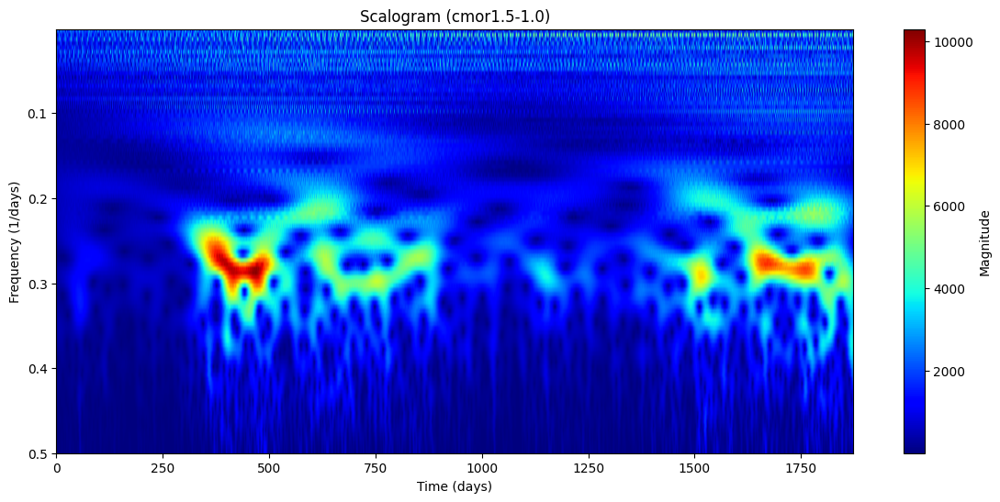

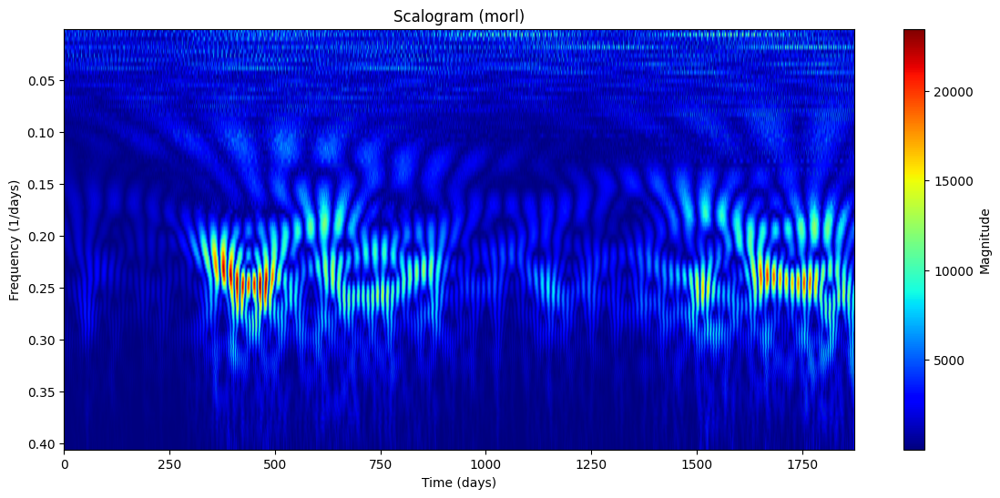

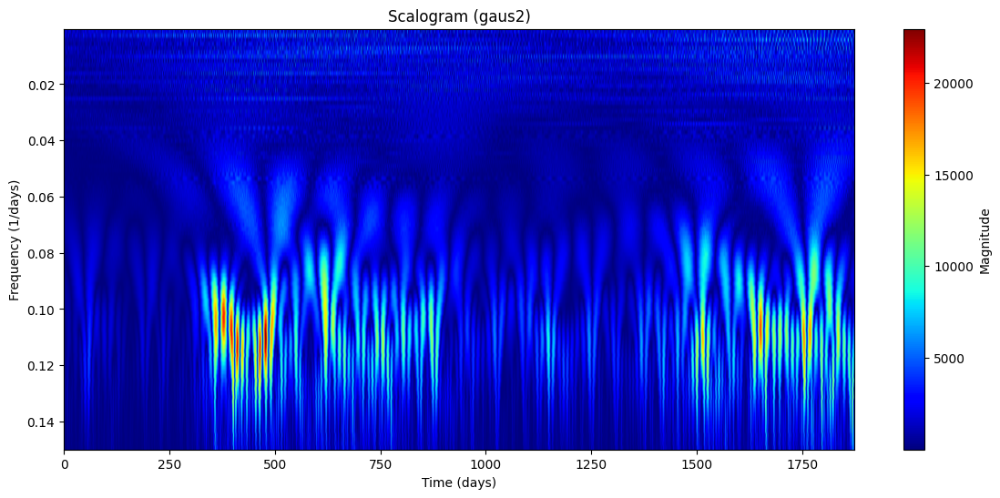

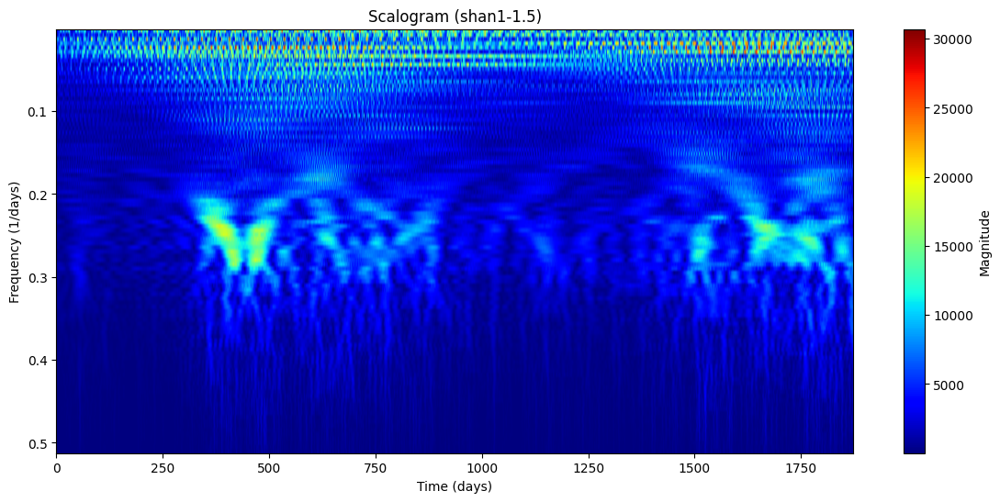

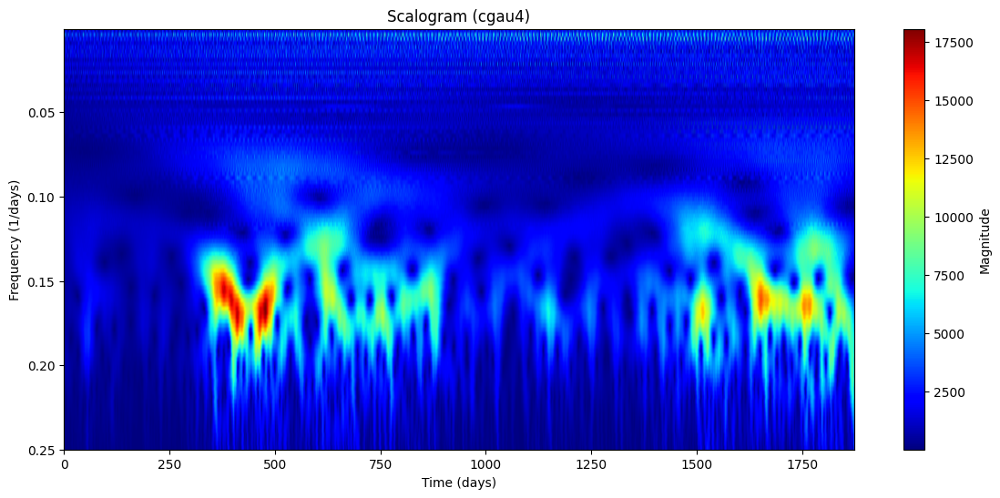

In [8]:
def cwt_analysis(data, wavelet_name='cmor1.5-1.0', scales=None, coif=None): #добавляем coif для отрисовки
    """
    Выполняет непрерывное вейвлет-преобразование (CWT) и визуализирует скалограмму.

    Args:
        data (pd.Series): Временной ряд для анализа (например, остатки).
        wavelet_name (str): Имя вейвлета (см. документацию PyWavelets).
                             Примеры: 'morl', 'gaus2', 'shan', 'cmorB-C' (B - полоса, C - центр. частота)
        scales (np.ndarray): Массив масштабов для CWT.  Если None, генерируется автоматически.
        coif(str): имя вейвлета для отрисовки самого вейвлета.

    Returns:
        tuple: (coef, frequencies) - вейвлет-коэффициенты и соответствующие частоты.
    """

    # 1. Определение масштабов
    if scales is None:
      #  scales = np.arange(1, 128) # Пример: линейный набор масштабов
        # Более разумный выбор для финансовых данных - логарифмический:
        scales = np.logspace(np.log10(2), np.log10(len(data)/2), num=100) #logspace - логарифмически-равномерная шкала

    # 2. Выполнение CWT
    coef, frequencies = pywt.cwt(data, scales, wavelet_name, sampling_period=1) #sampling_period=1, т.к. у нас шаг = 1 день

    # 3. Визуализация скалограммы
    plt.figure(figsize=(14, 6))
    plt.imshow(abs(coef), extent=[0, len(data), frequencies[-1], frequencies[0]], aspect='auto',
               cmap='jet', origin='upper') #origin='upper' для правильной ориентации
    plt.colorbar(label='Magnitude')
    plt.title(f'Scalogram ({wavelet_name})')
    plt.ylabel('Frequency (1/days)')  # Частота в обратных днях
    plt.xlabel('Time (days)')
    plt.gca().invert_yaxis() #перевернем ось Y

    #Отрисовка самого вейвлета
    if coif is not None:
        try: #added try-except block
            wavelet = pywt.Wavelet(coif.split('-')[0]) # Исправлено: берем только имя вейвлета, без параметров для отрисовки
            if wavelet.complex_cwt: #проверка на комплексность вейвлета
                [phi, x] = wavelet.wavefun(level=10)
                plt.figure(figsize=(14,3))
                plt.plot(x, np.real(phi), label='Real')
                plt.plot(x, np.imag(phi), label='Imaginary')
                plt.title(f'Wavelet: {coif}')
                plt.legend()
            else:
                [phi, psi, x] = wavelet.wavefun(level=10)
                plt.figure(figsize=(14,3))
                plt.plot(x,psi)
                plt.title(f'Wavelet: {coif}')
        except ValueError as e:
            print(f"Warning: Could not plot wavelet '{coif}': {e}") # Added warning, not critical error

    plt.show()

    return coef, frequencies


# Пример использования:

# Выберем одну криптовалюту и остатки из предыдущей декомпозиции
ticker = 'BTC-USD'
residuals = decomposed_crypto_data[ticker]['residuals']

# Примеры использования с разными вейвлетами:
# 1. Complex Morlet (cmorB-C)
coef_cmor, frequencies_cmor = cwt_analysis(residuals, wavelet_name='cmor1.5-1.0', coif='cmor1.5-1.0') #B=1.5, C=1.0 - параметры

# 2. Morlet (morl)
coef_morl, frequencies_morl = cwt_analysis(residuals, wavelet_name='morl', coif='morl')

# 3. Gaussian derivative (gaus2) - вторая производная Гаусса
coef_gaus, frequencies_gaus = cwt_analysis(residuals, wavelet_name='gaus2', coif='gaus2')

# 4. Shannon (shan) - вейвлет Шеннона.  Пример: shanB-C, где B - полоса, C - центр. частота
coef_shan, frequencies_shan = cwt_analysis(residuals, wavelet_name='shan1-1.5', coif='shan1-1.5')

# 5. Complex Gaussian derivative
coef_cgau, frequencies_cgau = cwt_analysis(residuals, wavelet_name = 'cgau4', coif='cgau4')

Анализ BTC-USD с вейвлетом cmor1.5-1.0...


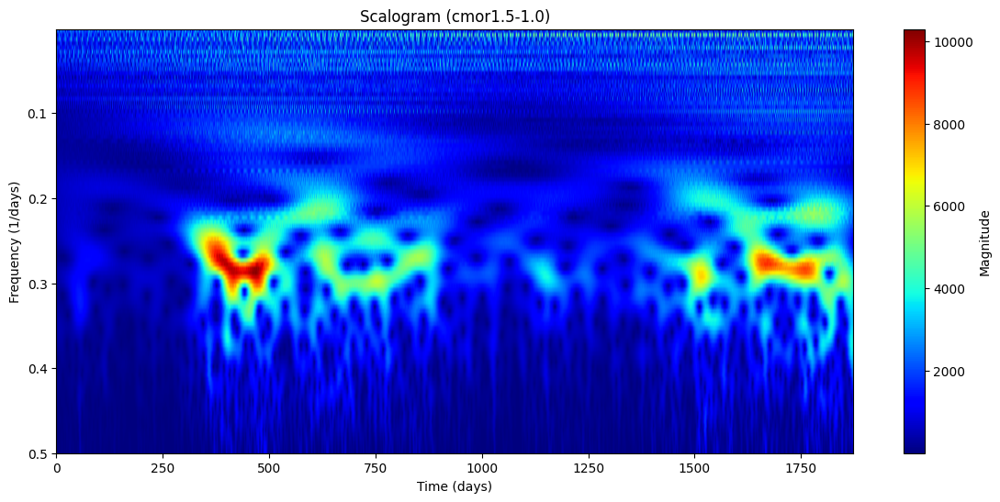

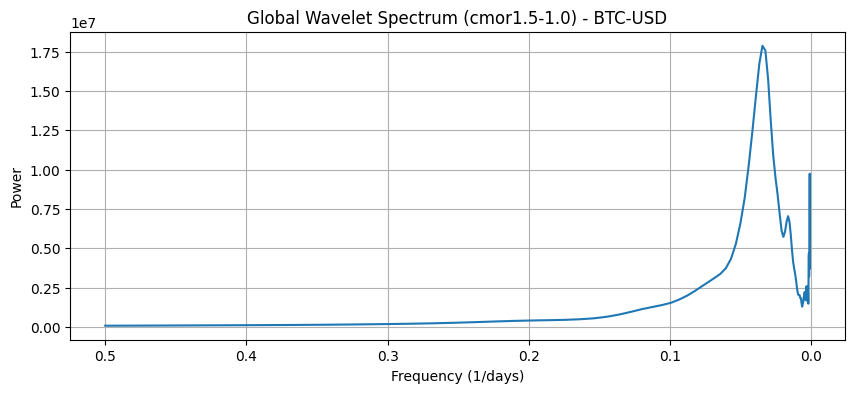

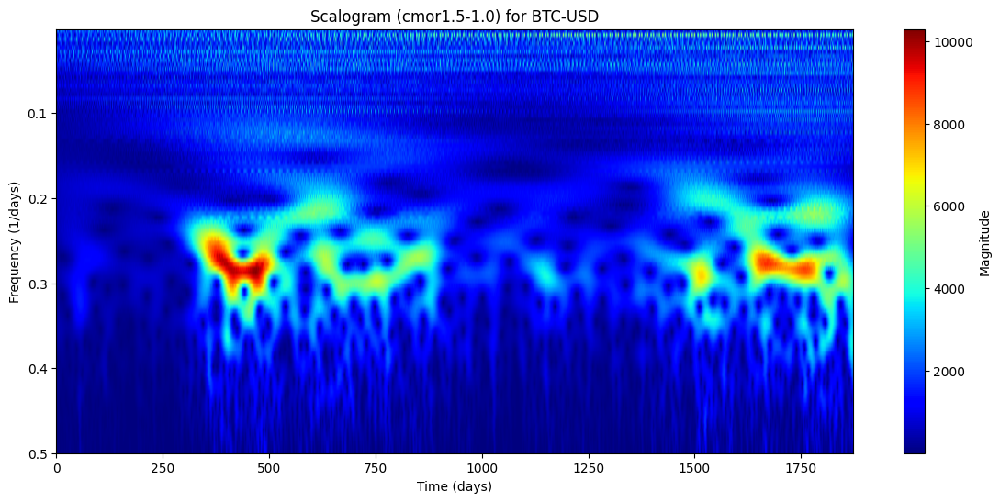

Анализ BTC-USD с вейвлетом morl...


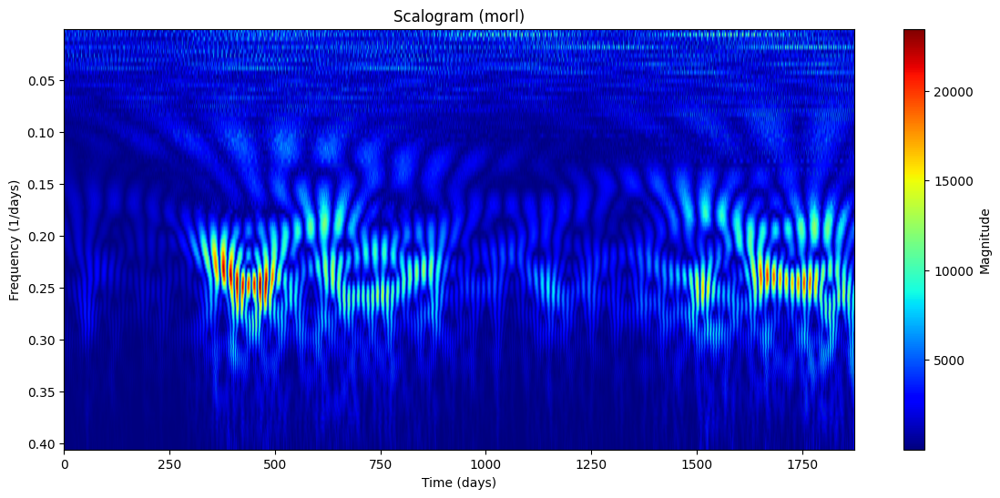

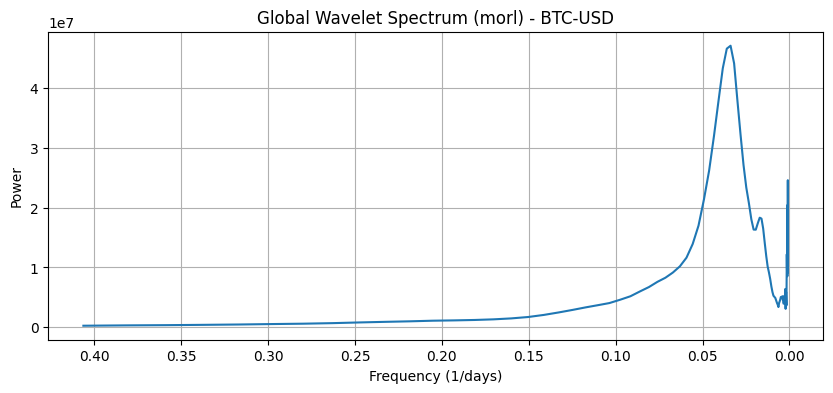

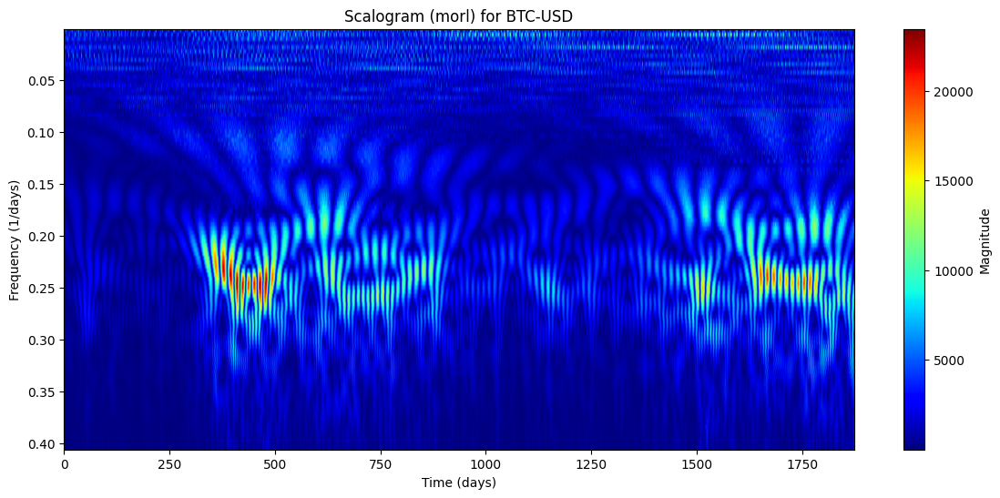

Анализ BTC-USD с вейвлетом gaus2...


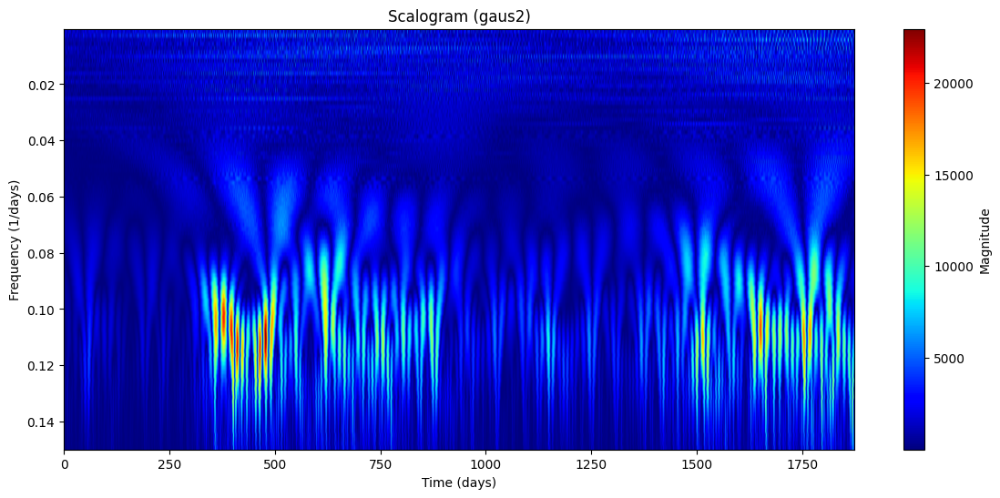

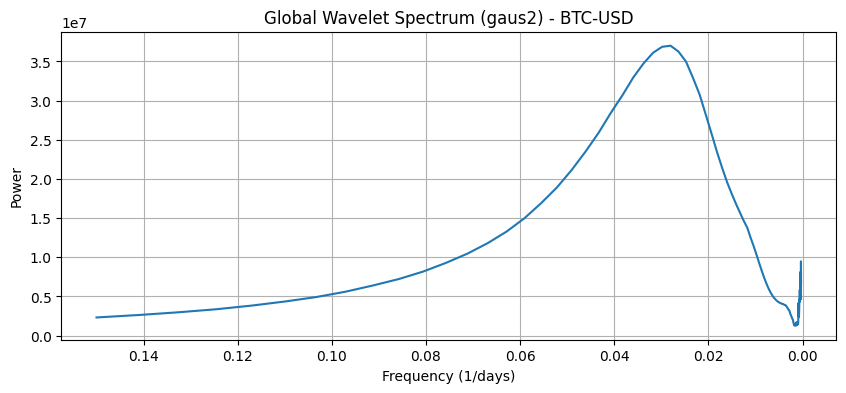

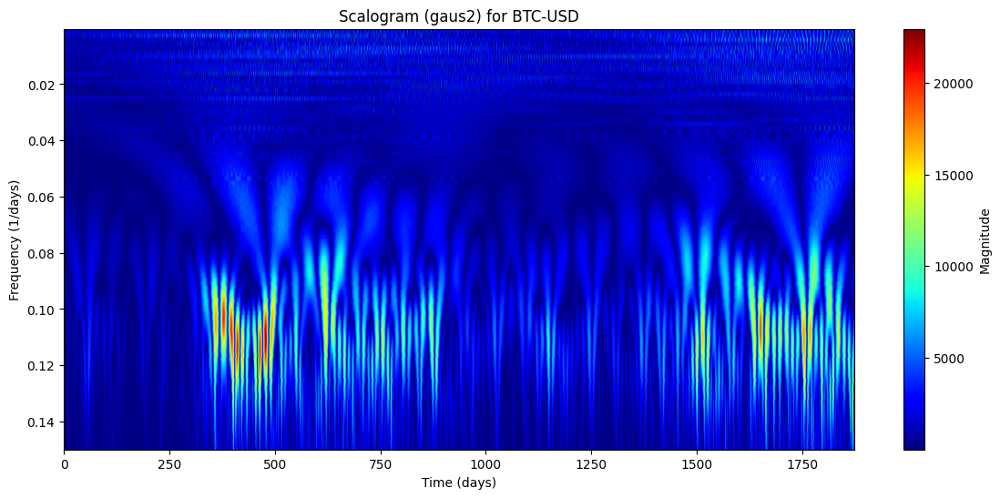

Анализ BTC-USD с вейвлетом shan1-1.5...


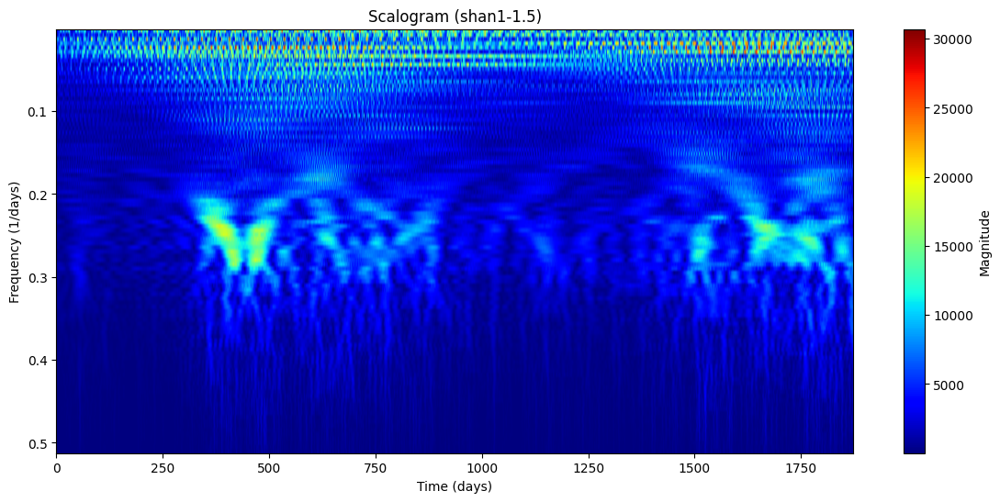

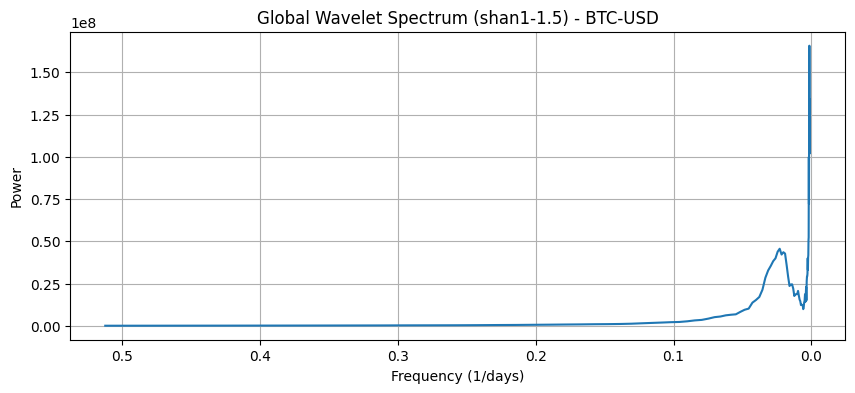

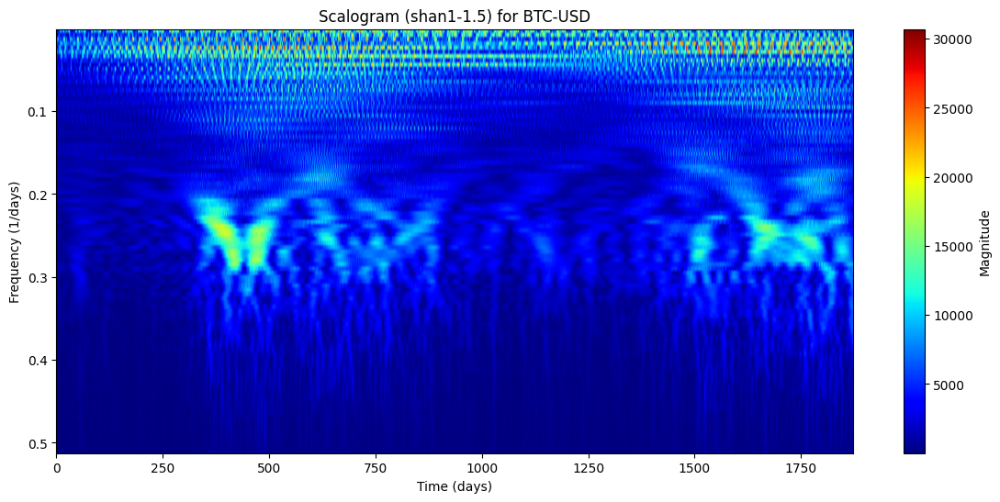

Анализ BTC-USD с вейвлетом cgau4...


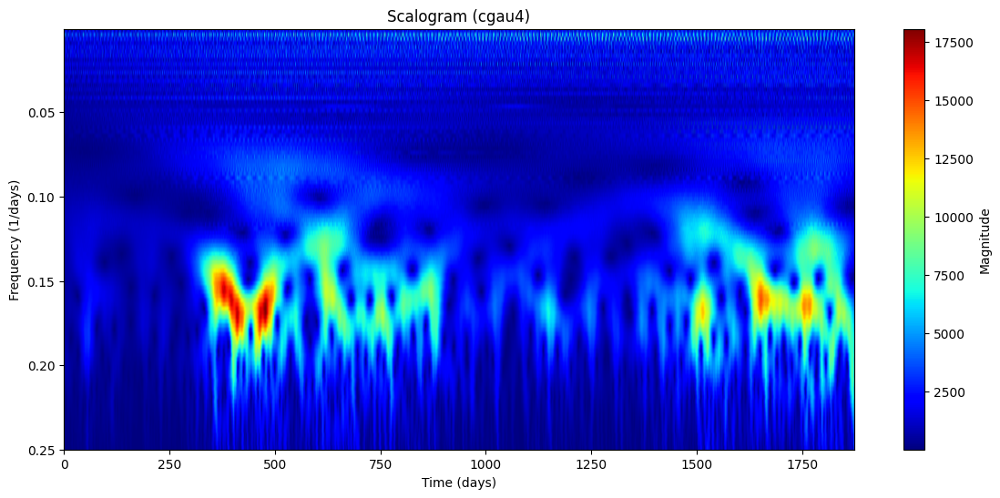

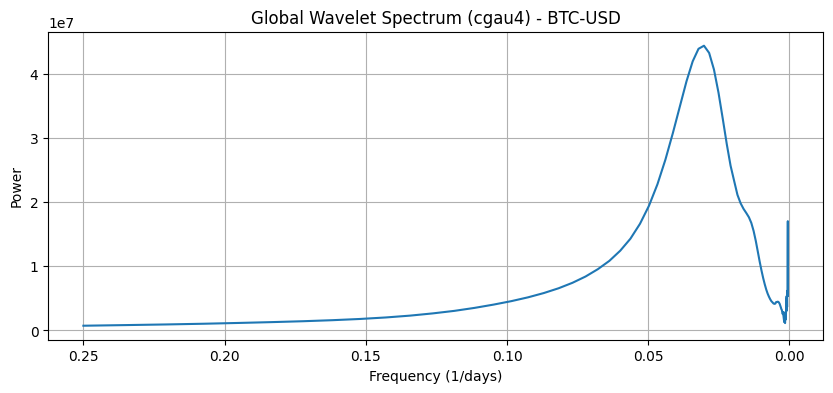

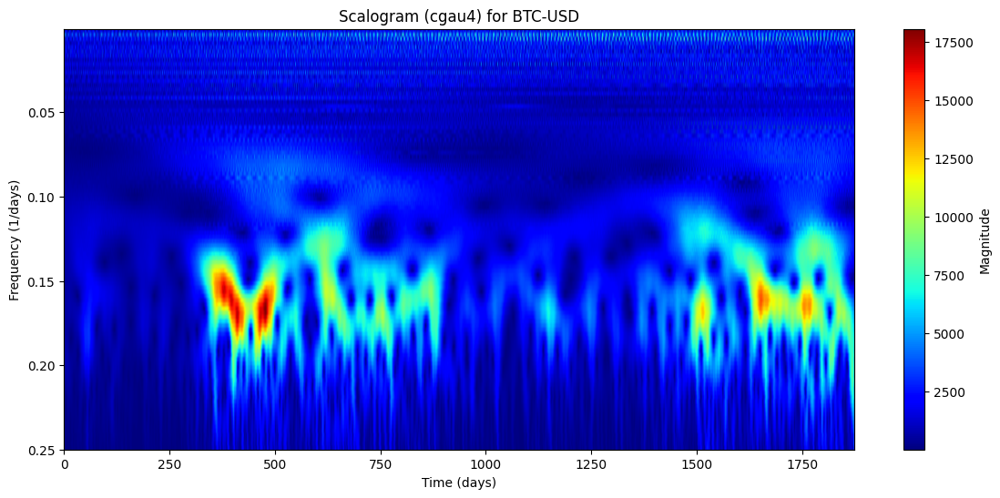

Анализ ETH-USD с вейвлетом cmor1.5-1.0...


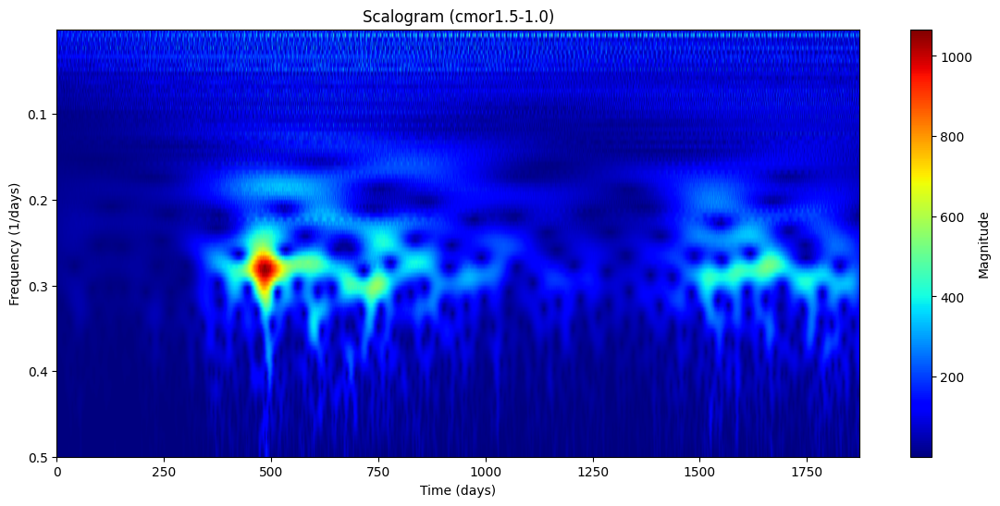

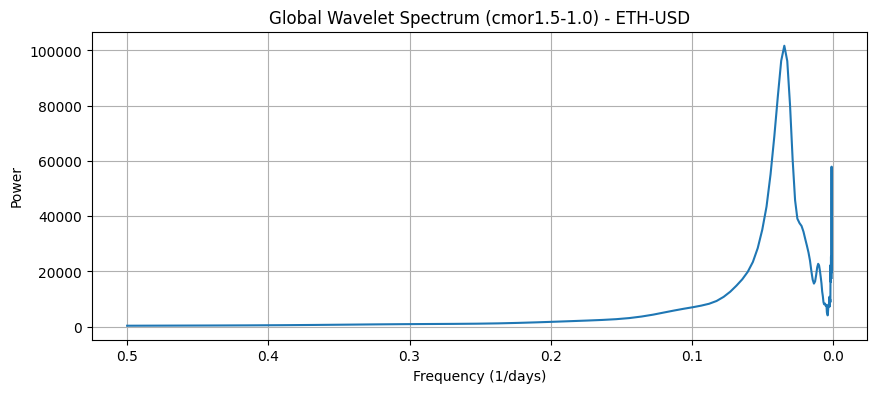

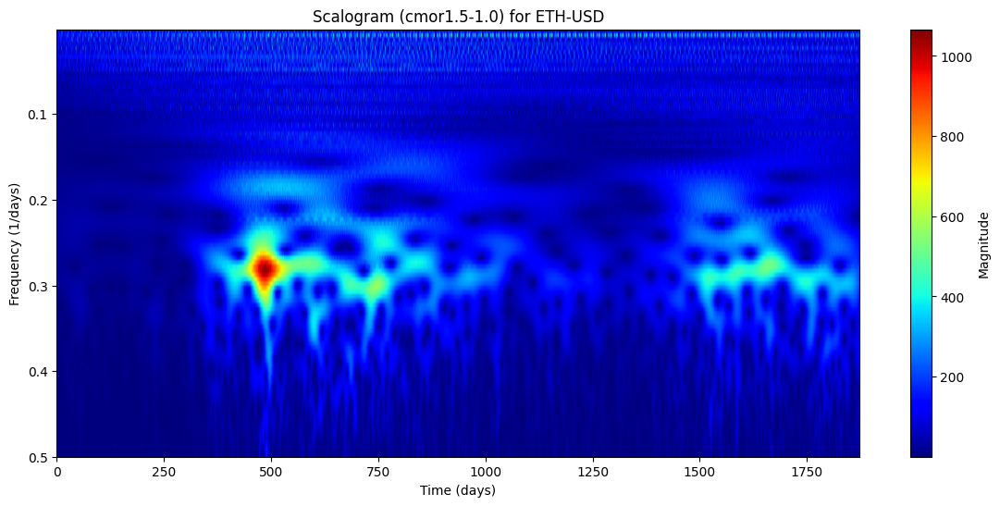

Анализ ETH-USD с вейвлетом morl...


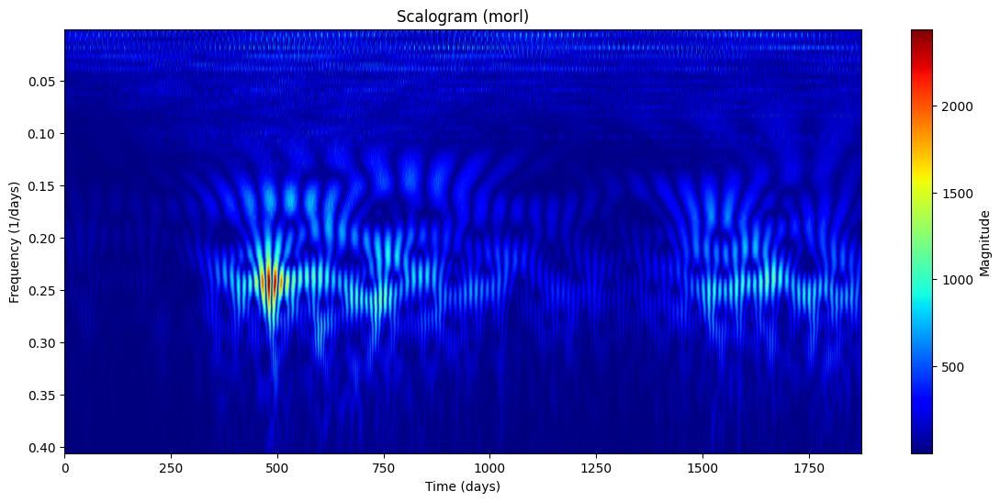

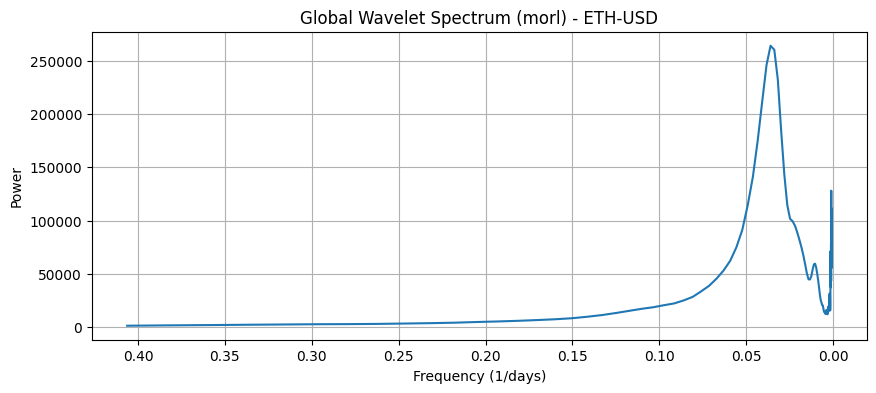

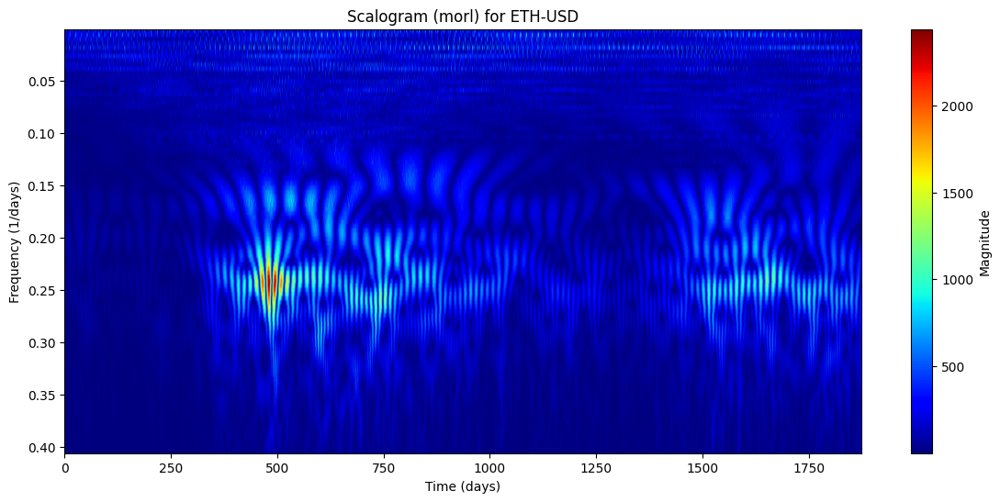

Анализ ETH-USD с вейвлетом gaus2...


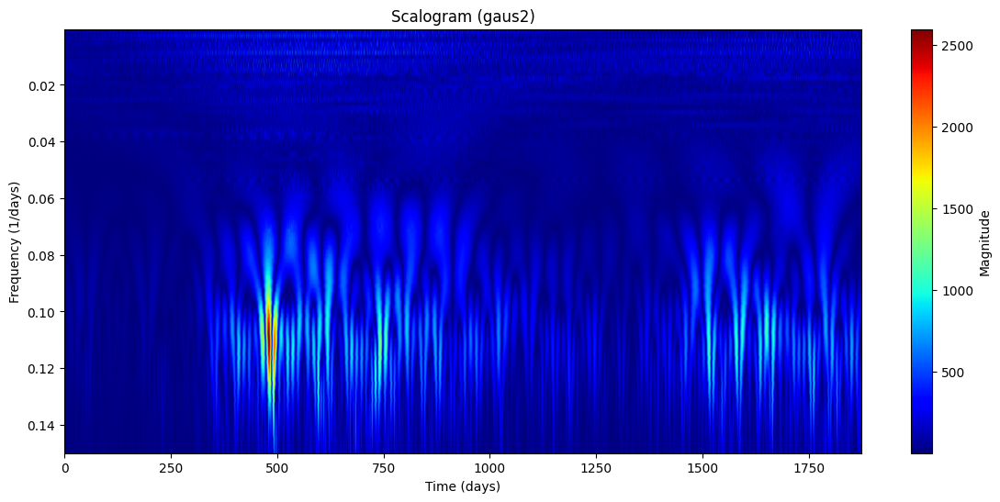

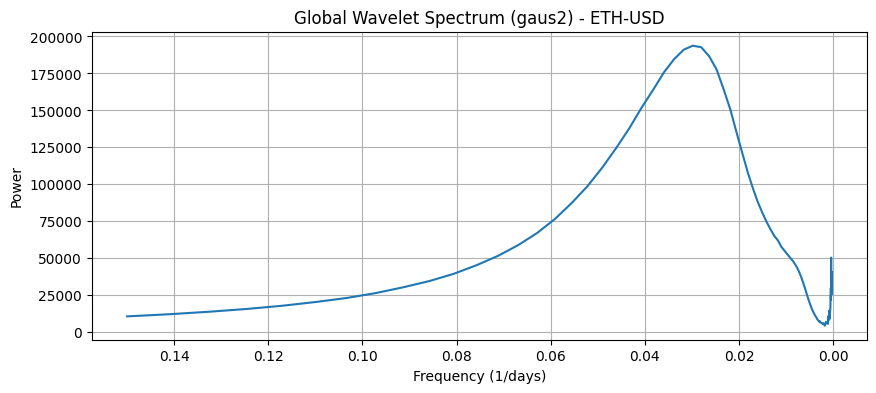

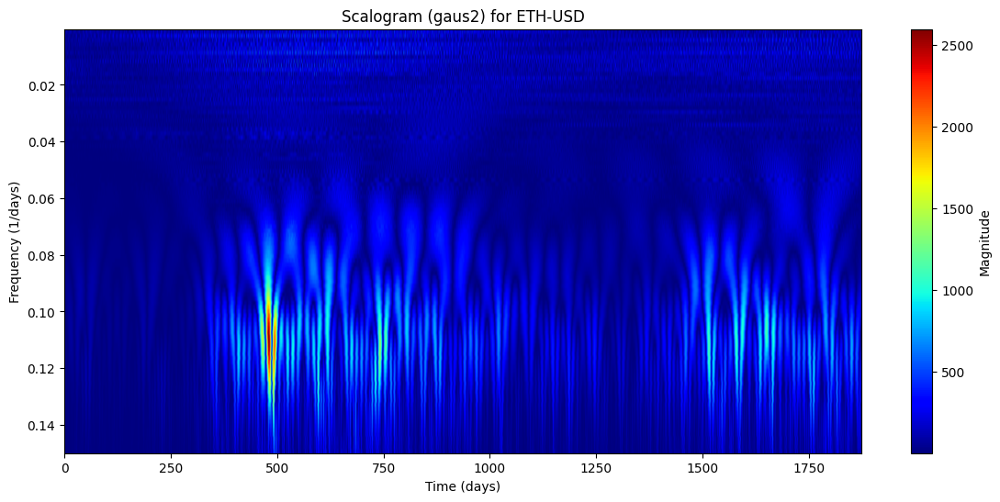

Анализ ETH-USD с вейвлетом shan1-1.5...


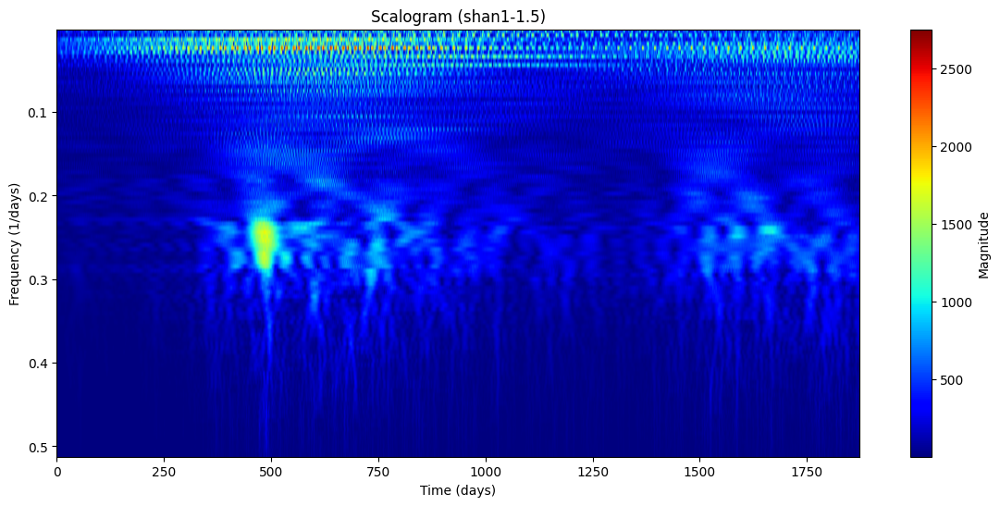

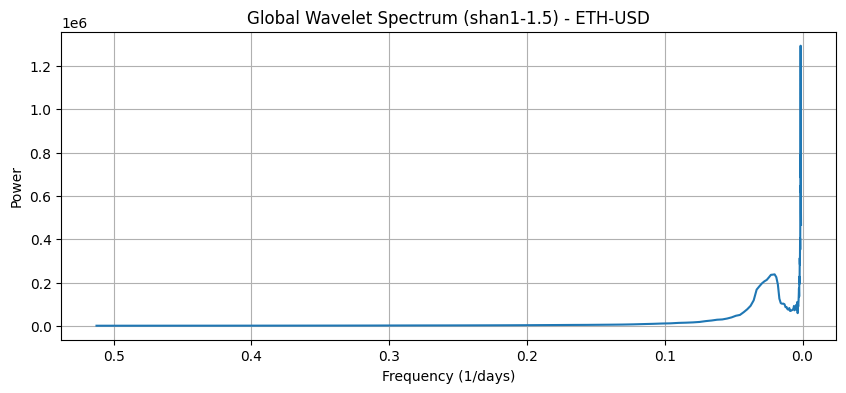

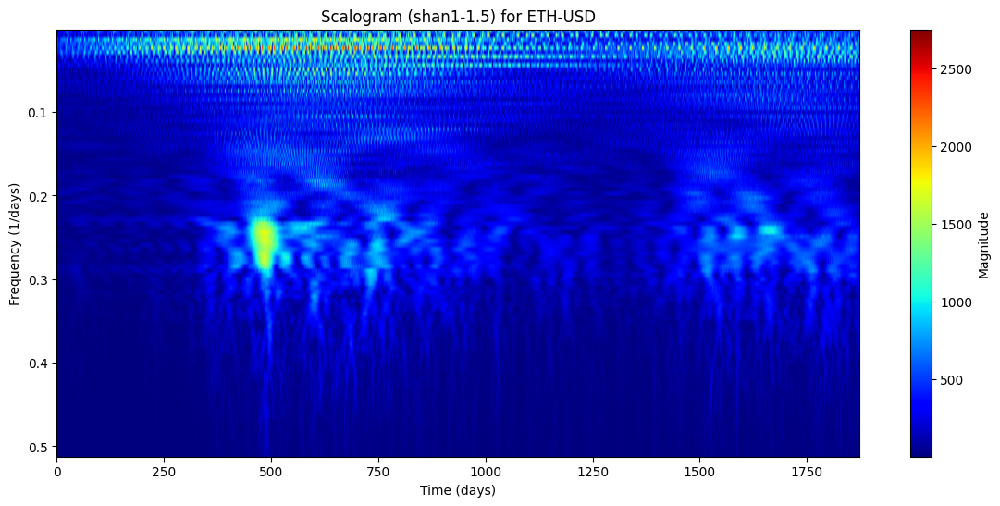

Анализ ETH-USD с вейвлетом cgau4...


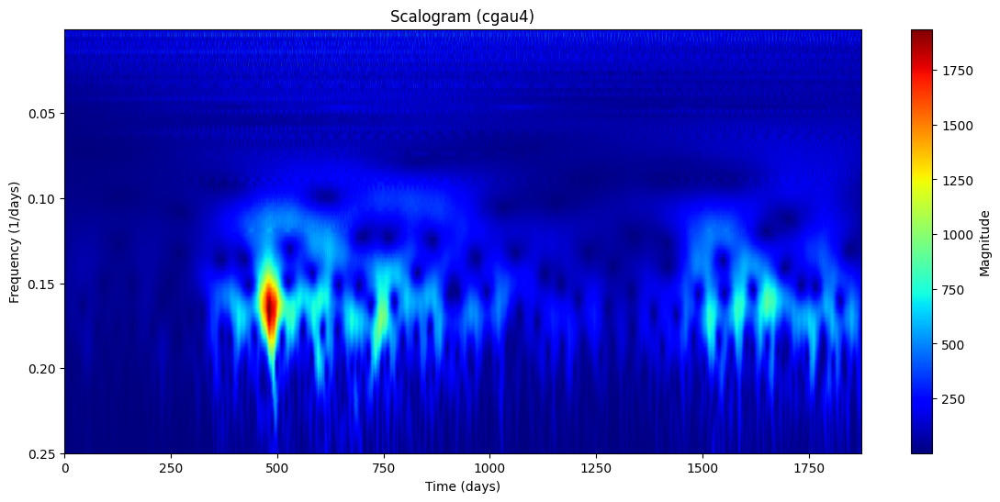

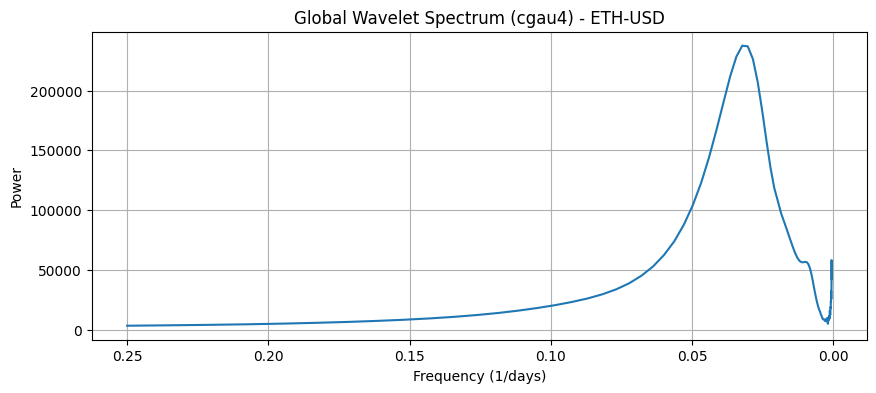

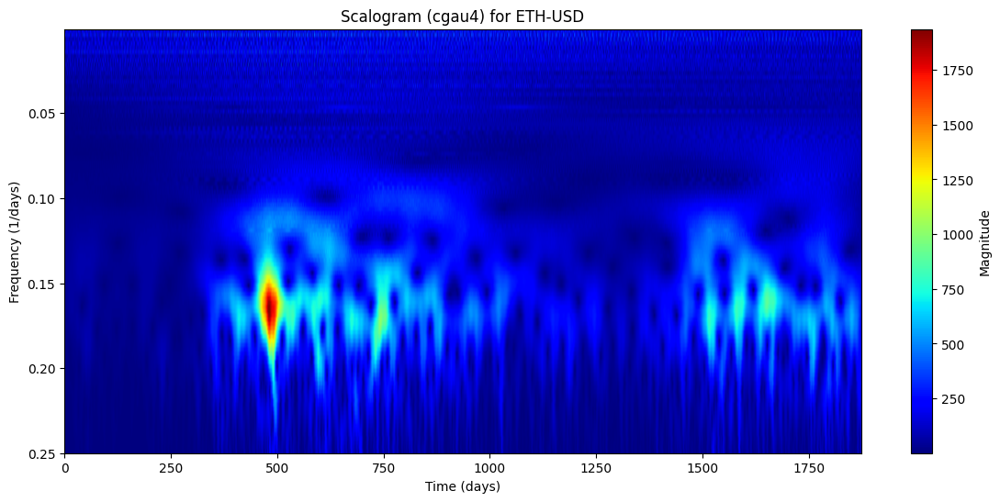

Анализ ADA-USD с вейвлетом cmor1.5-1.0...


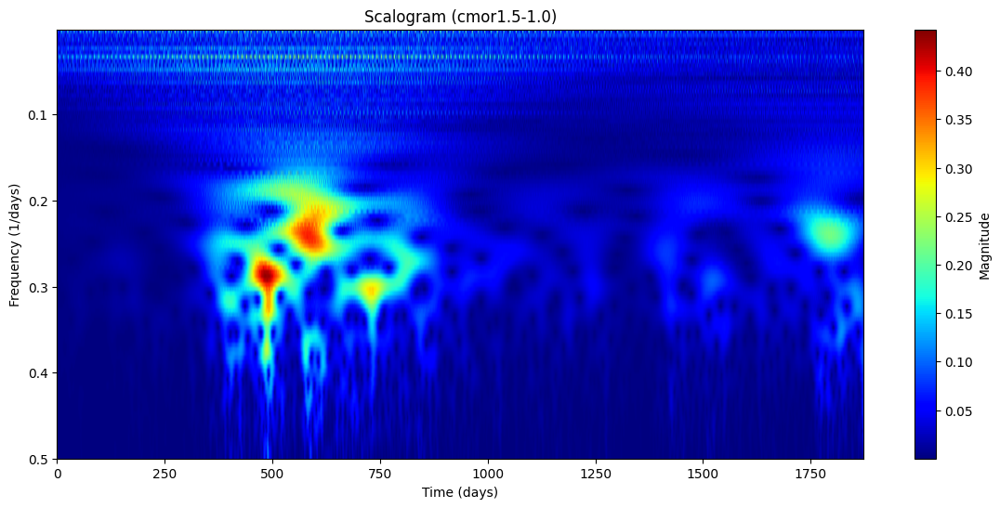

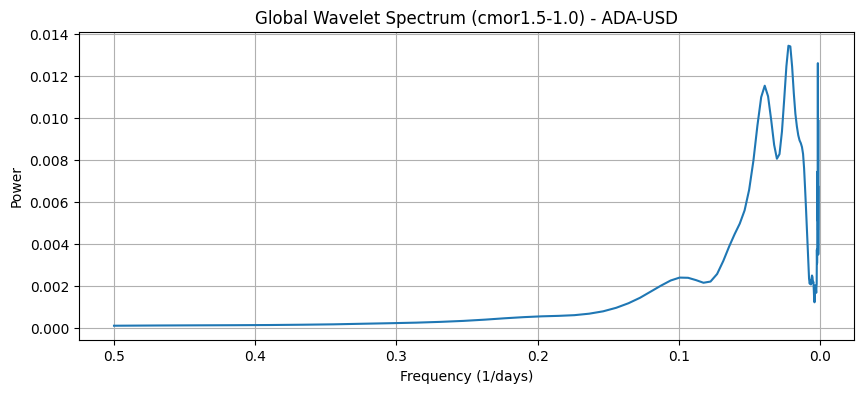

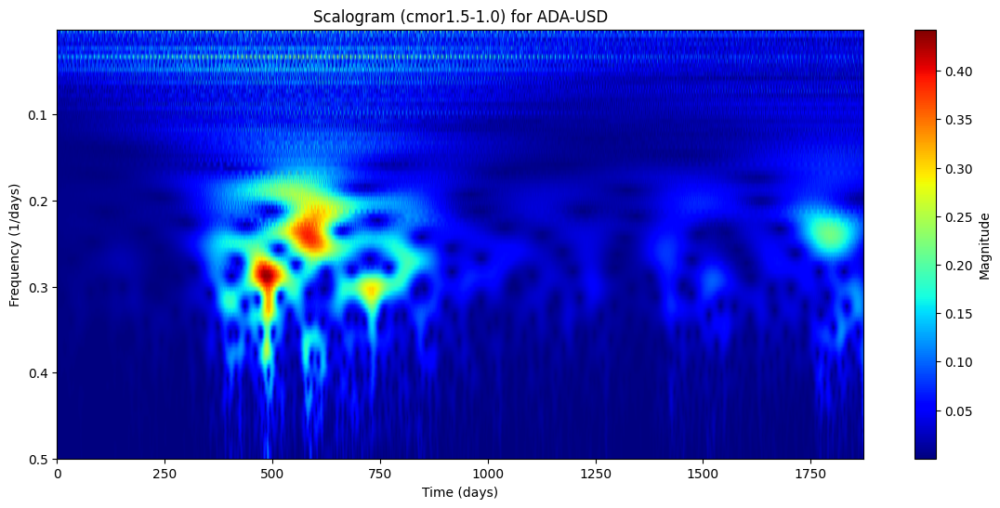

Анализ ADA-USD с вейвлетом morl...


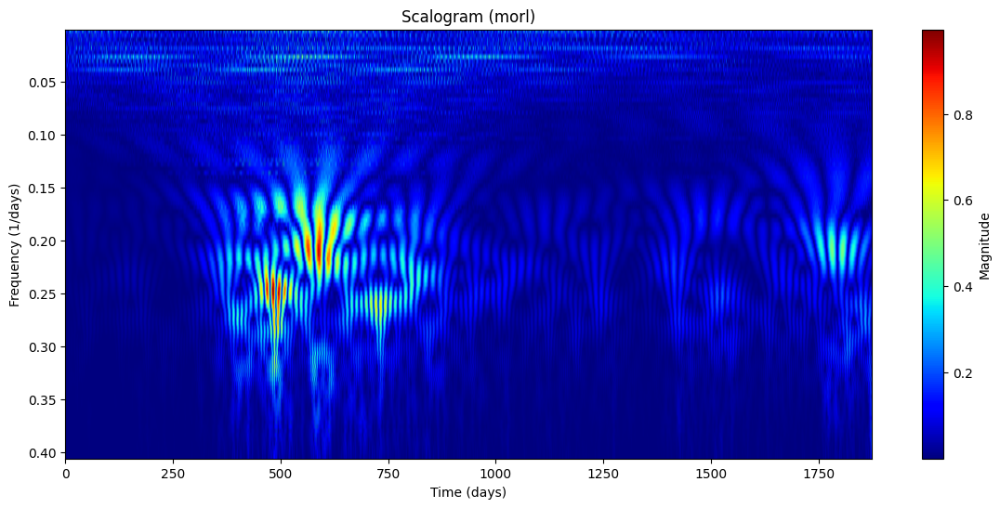

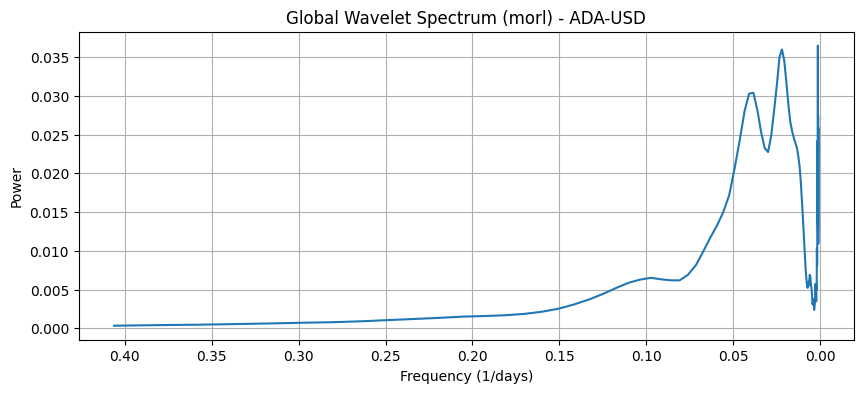

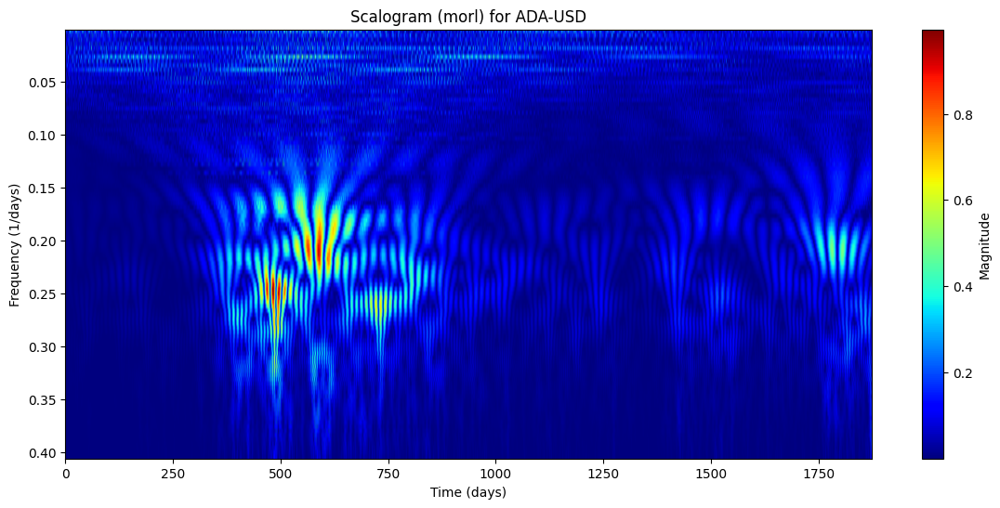

Анализ ADA-USD с вейвлетом gaus2...


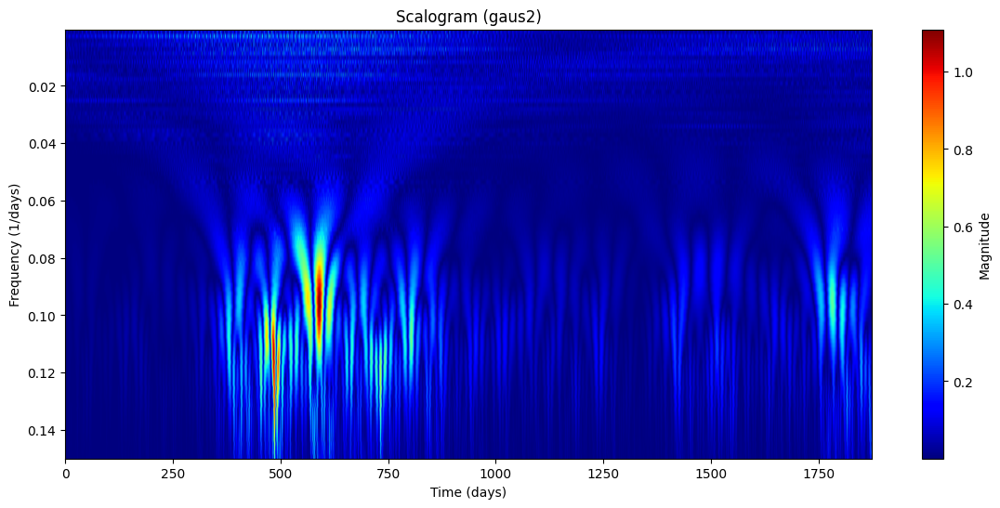

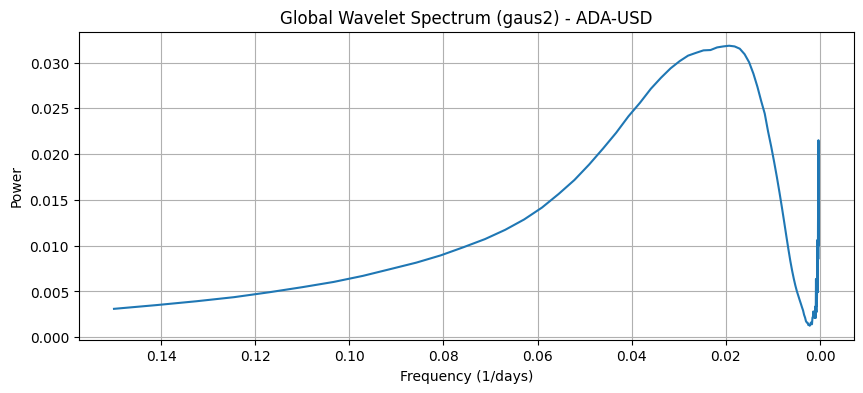

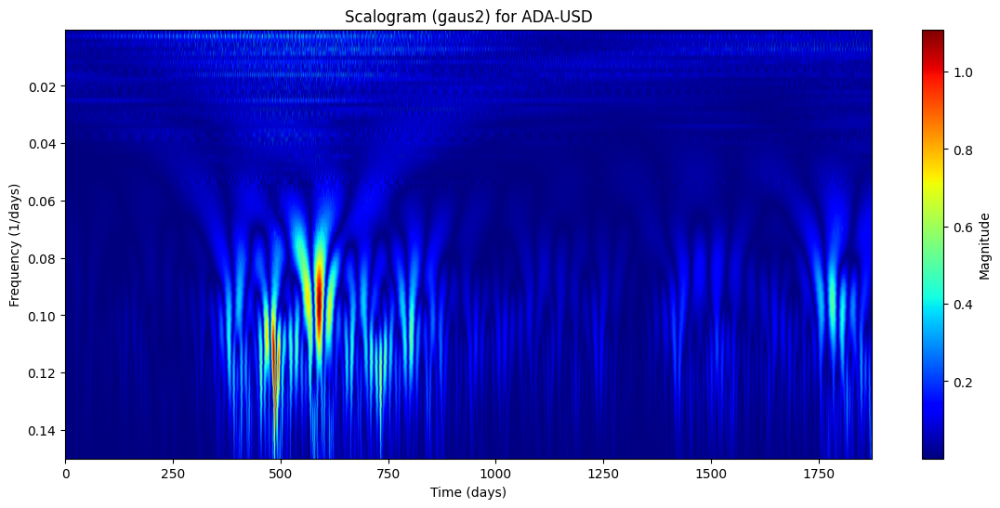

Анализ ADA-USD с вейвлетом shan1-1.5...


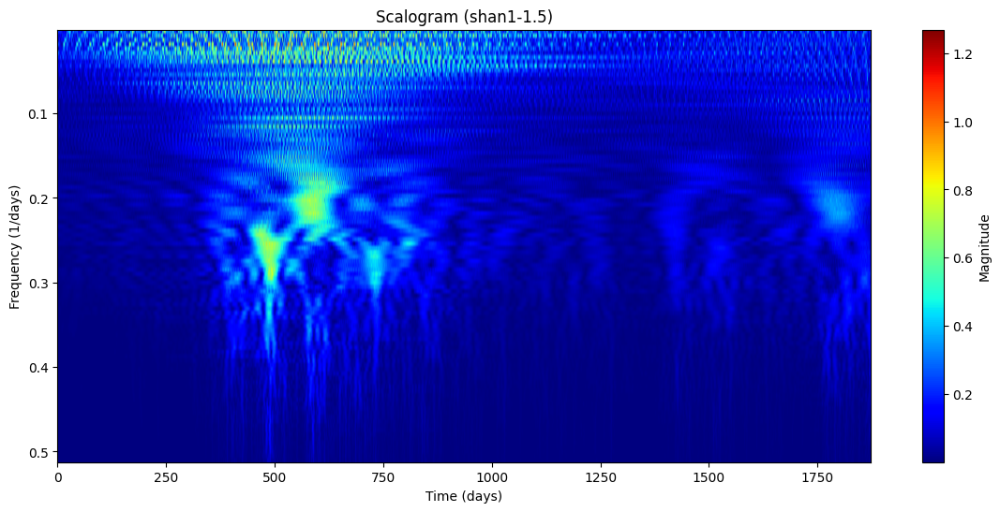

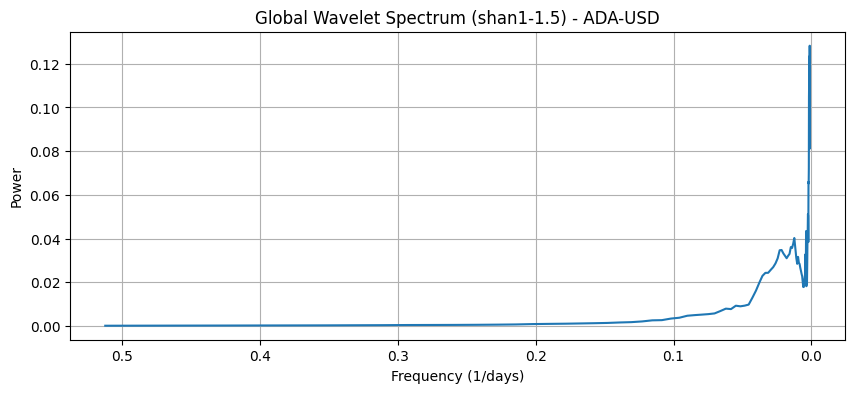

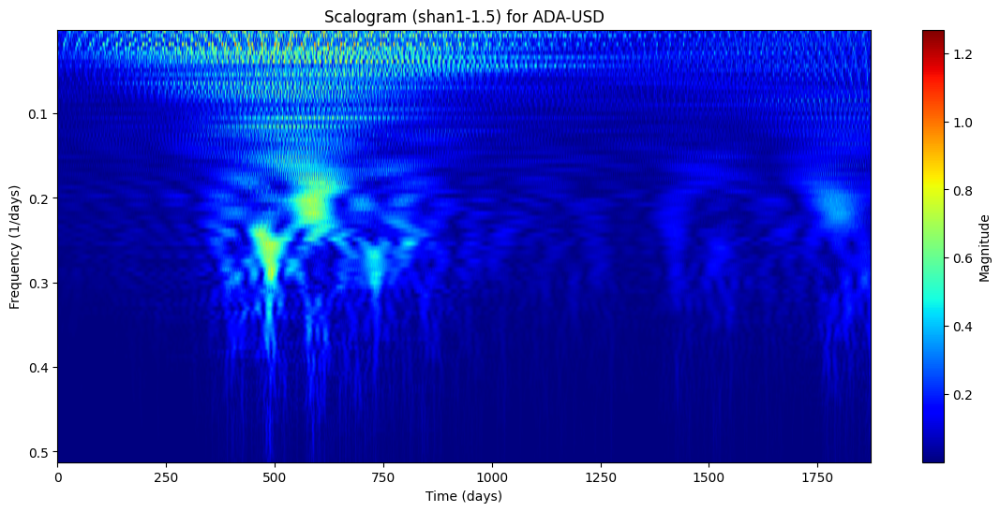

Анализ ADA-USD с вейвлетом cgau4...


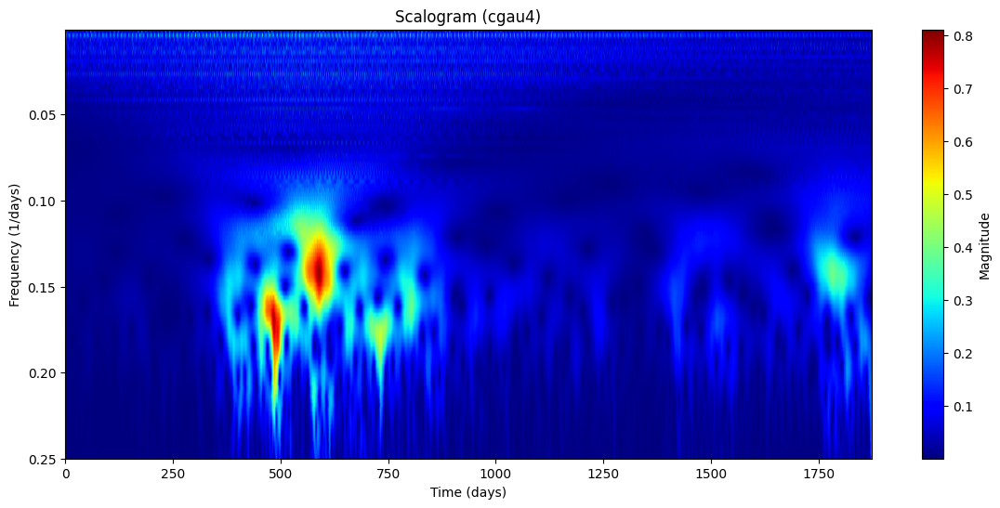

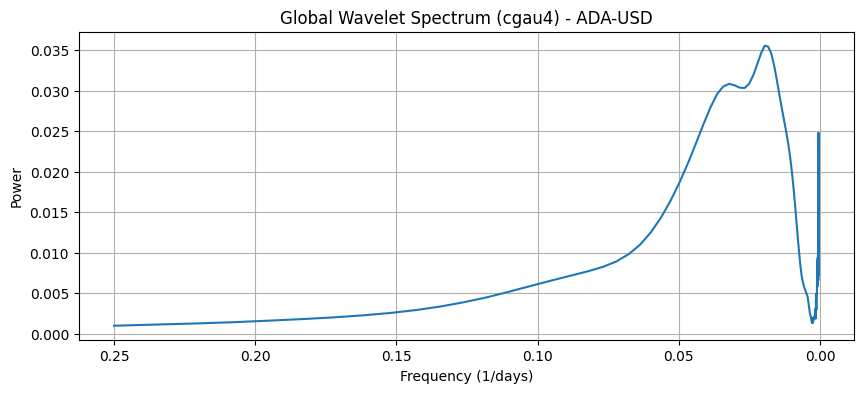

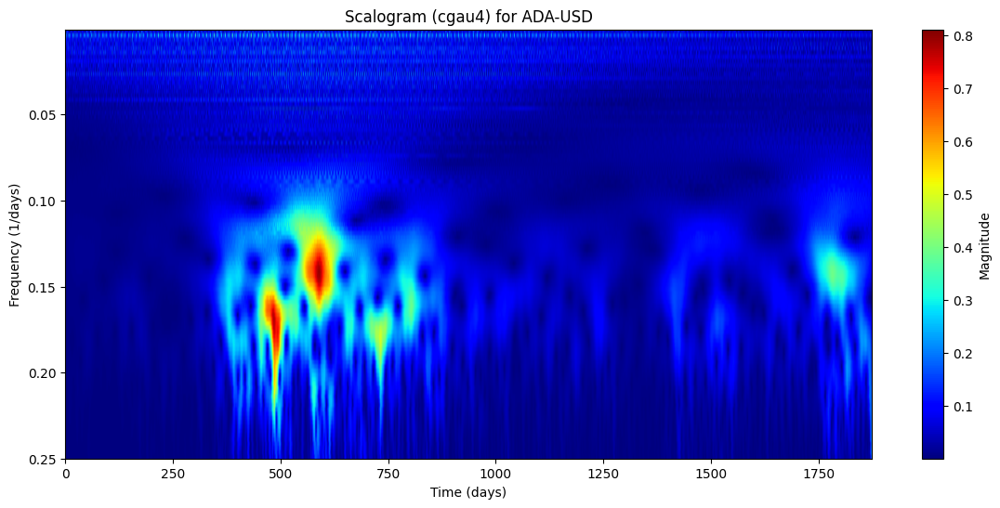

Анализ DOT-USD с вейвлетом cmor1.5-1.0...


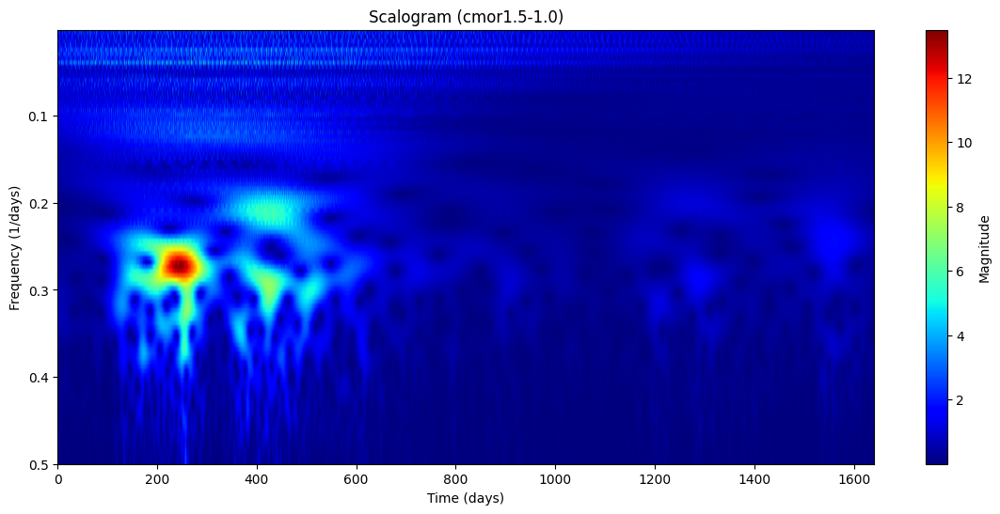

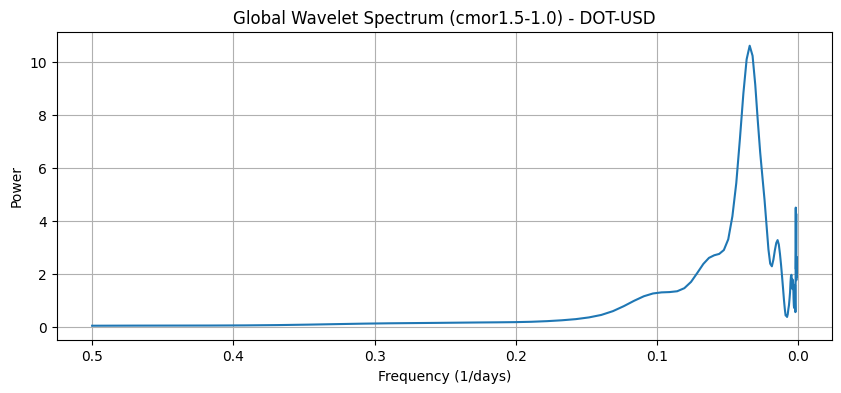

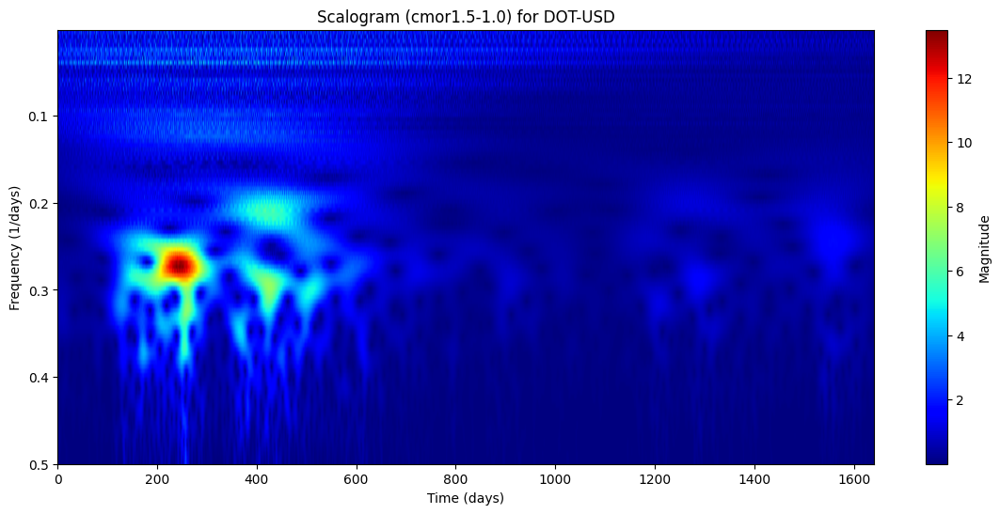

Анализ DOT-USD с вейвлетом morl...


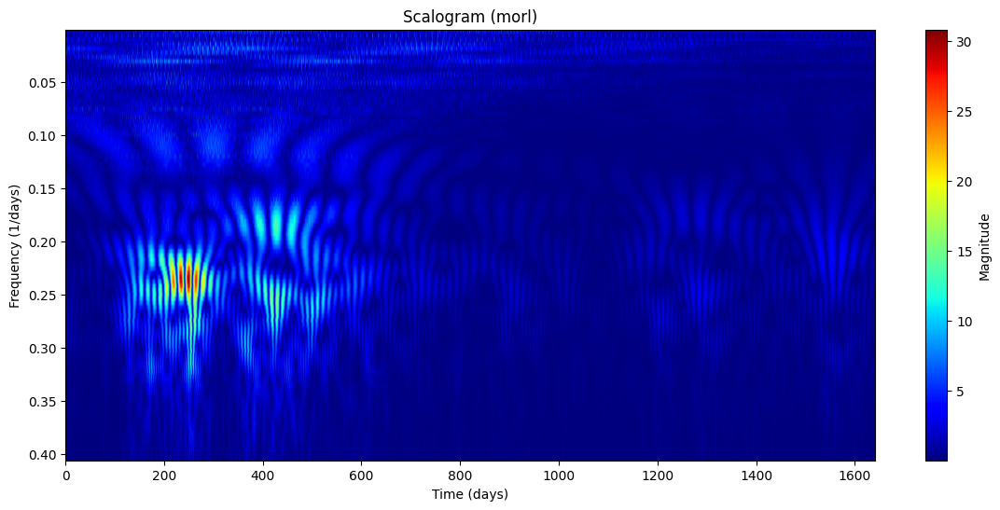

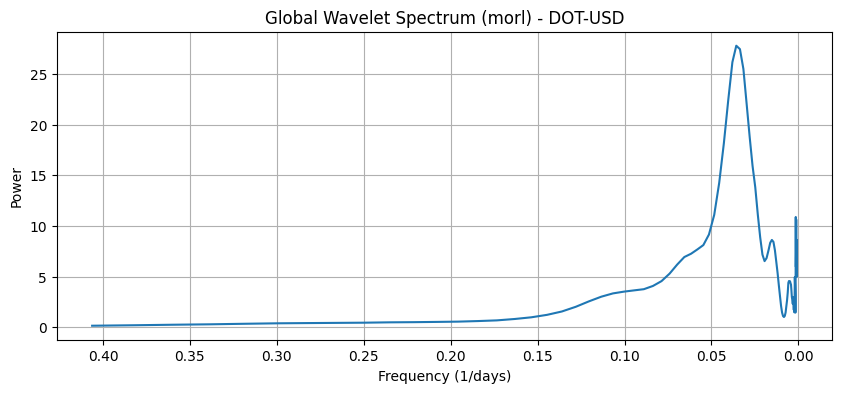

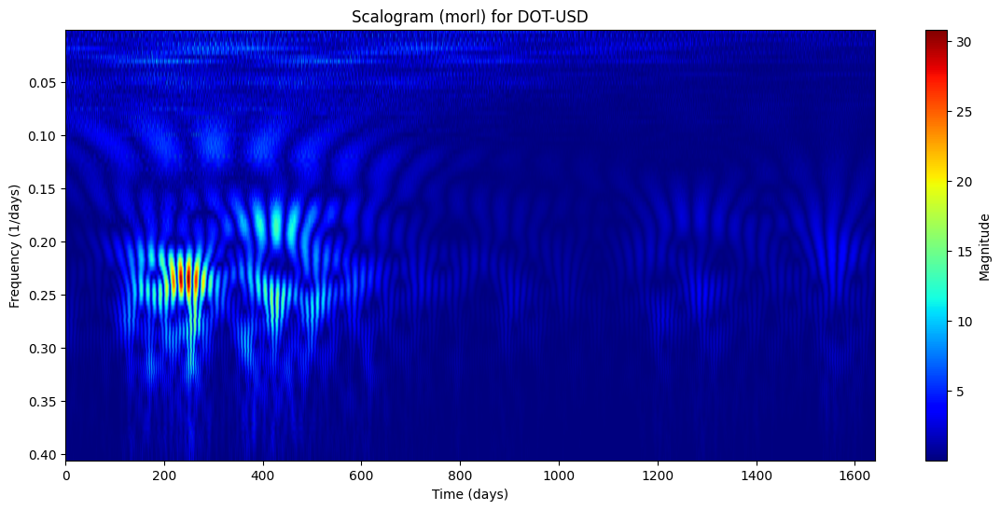

Анализ DOT-USD с вейвлетом gaus2...


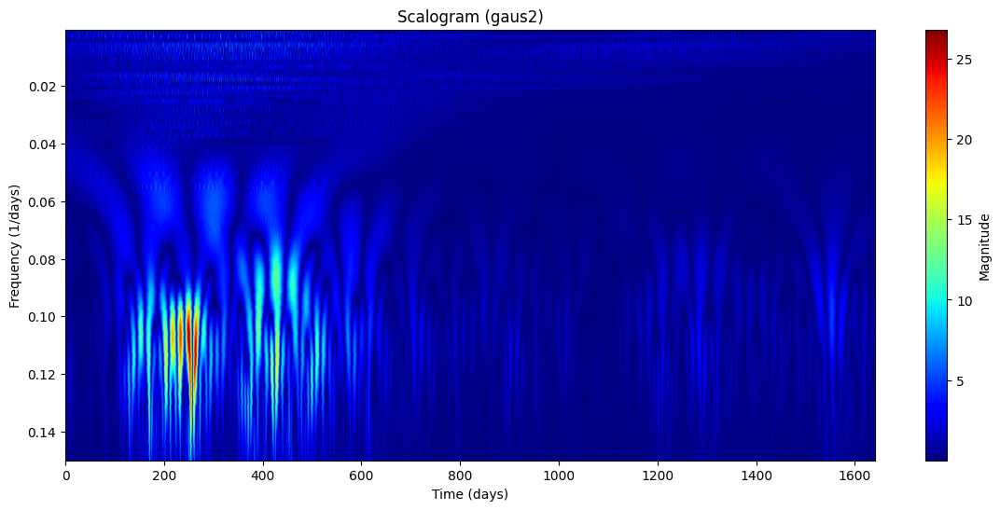

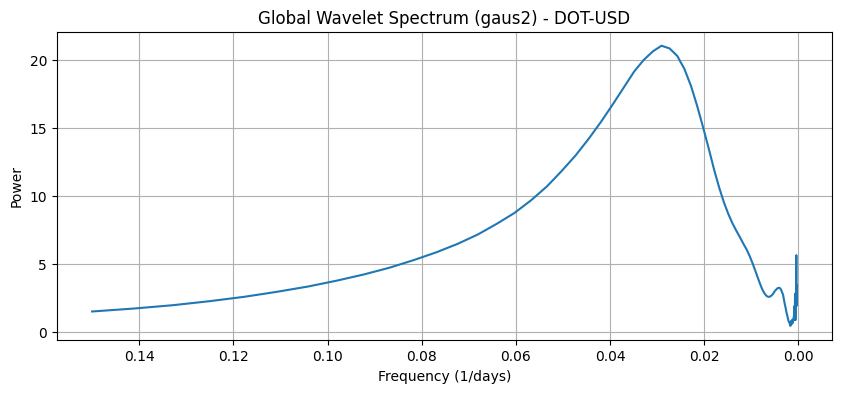

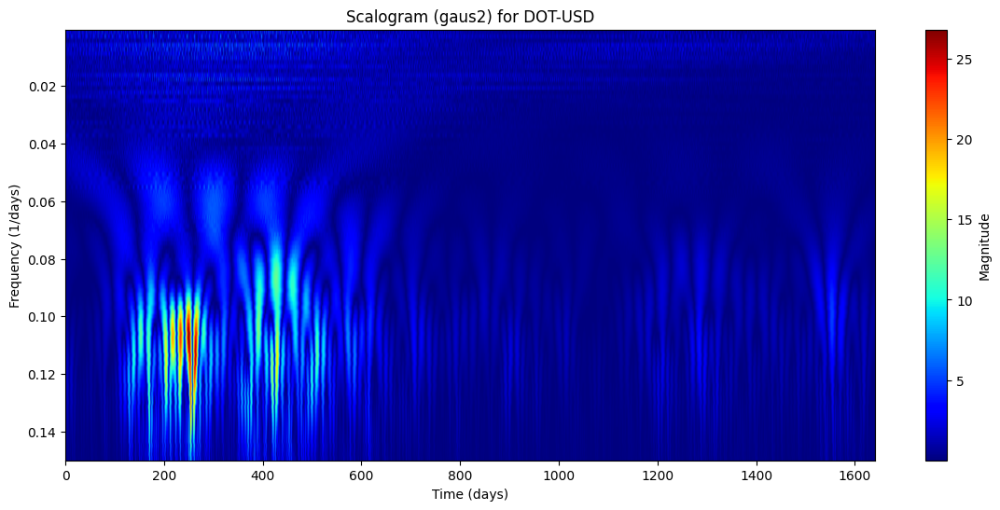

Анализ DOT-USD с вейвлетом shan1-1.5...


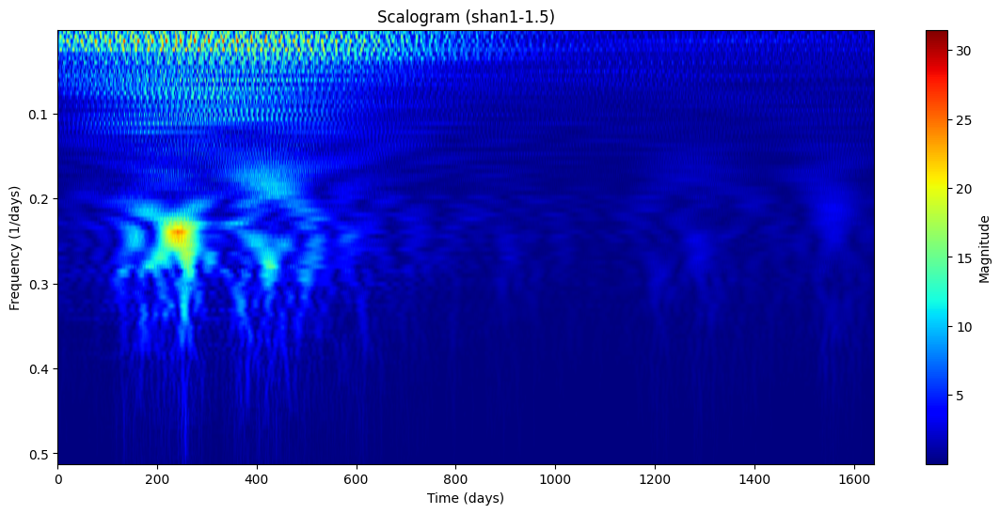

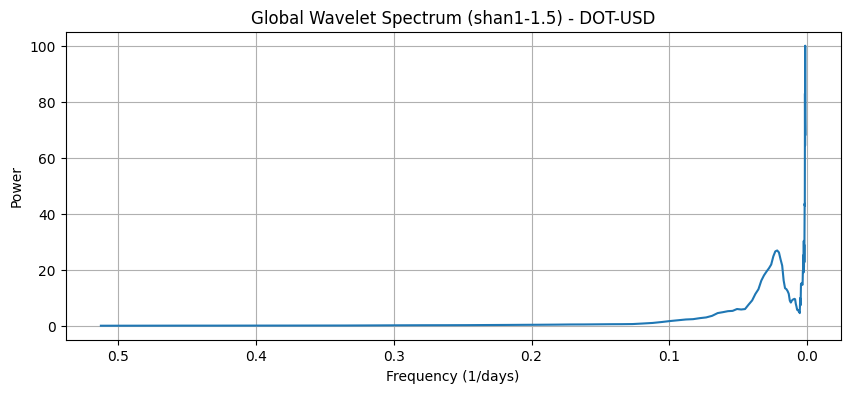

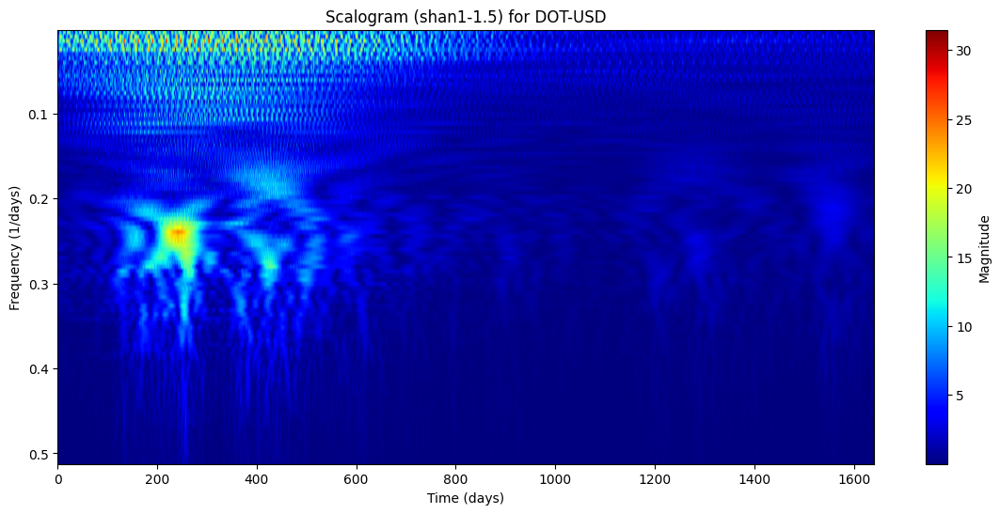

Анализ DOT-USD с вейвлетом cgau4...


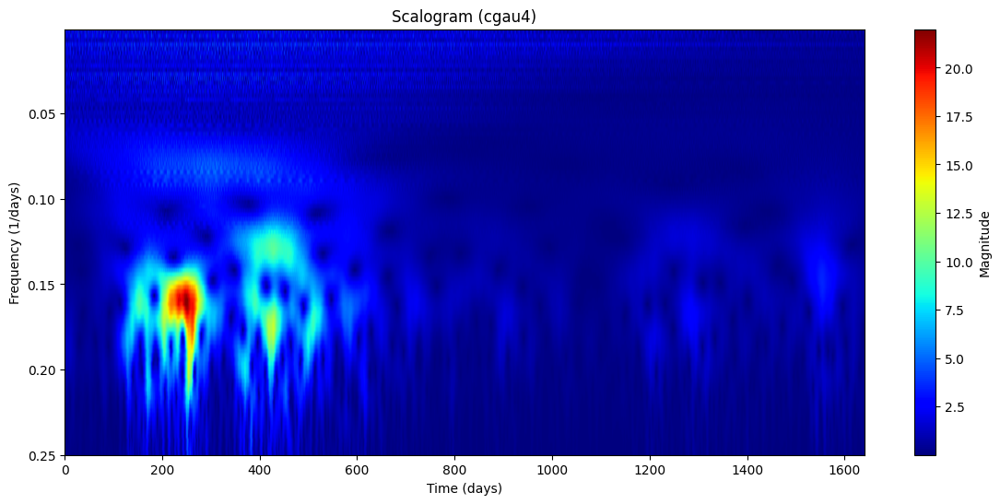

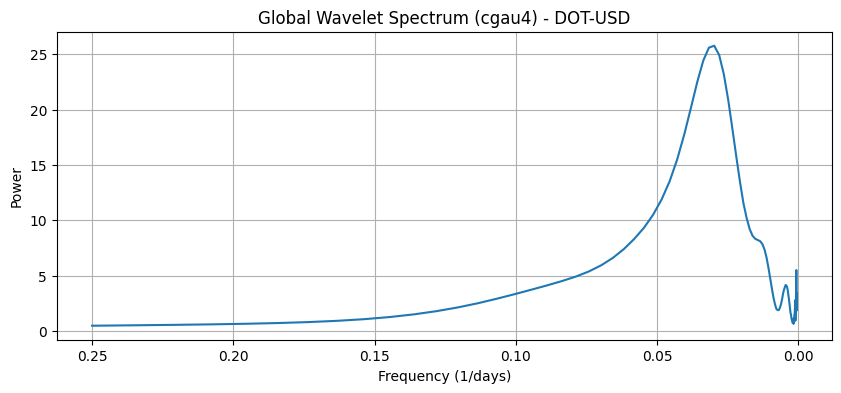

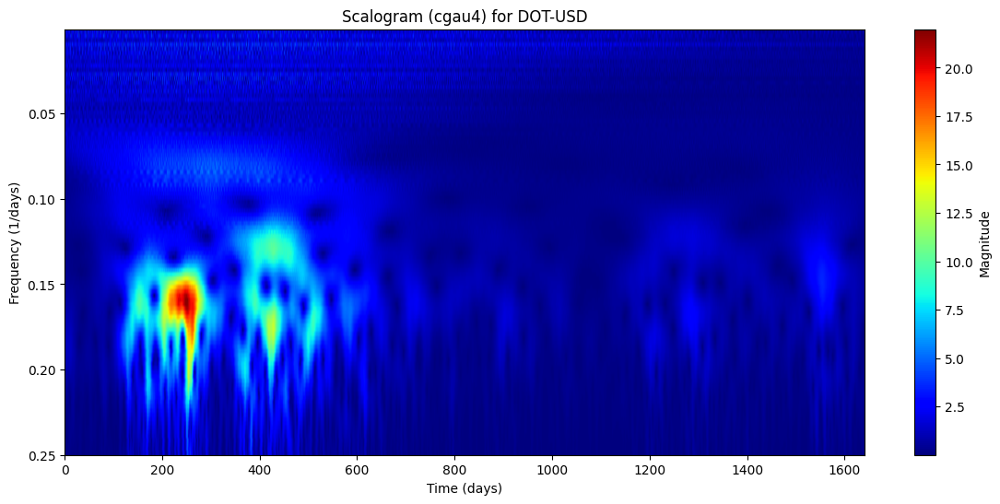

Анализ BNB-USD с вейвлетом cmor1.5-1.0...


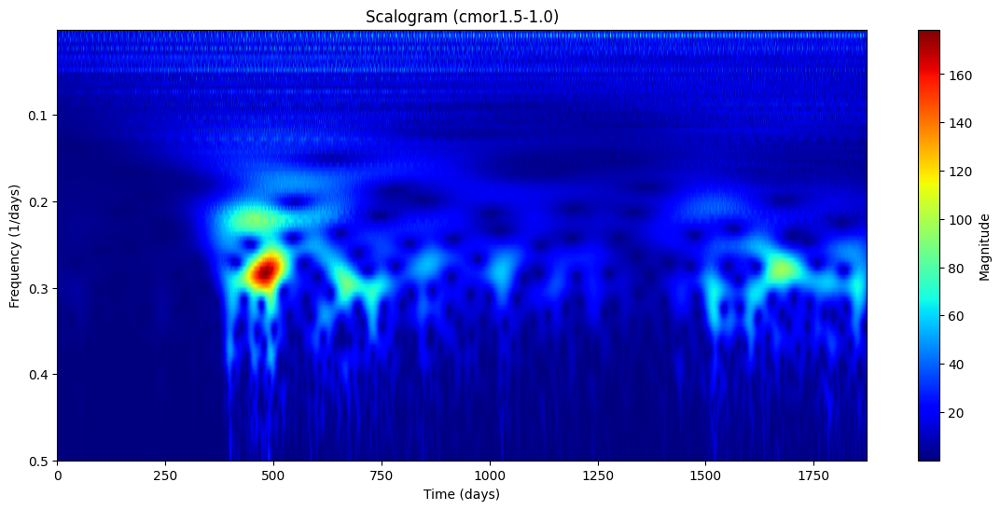

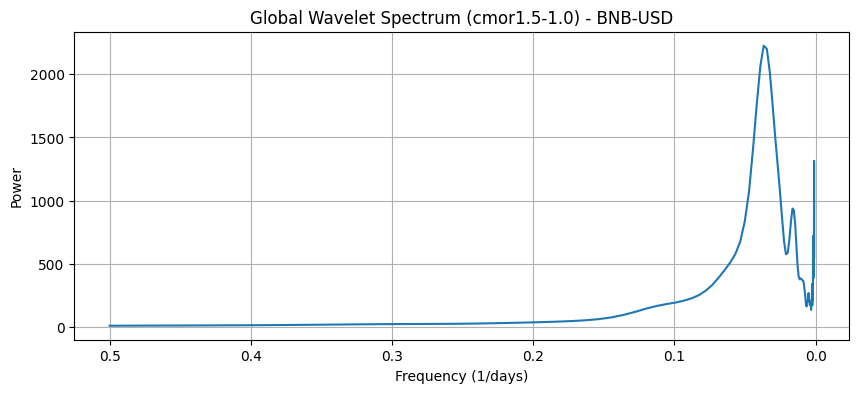

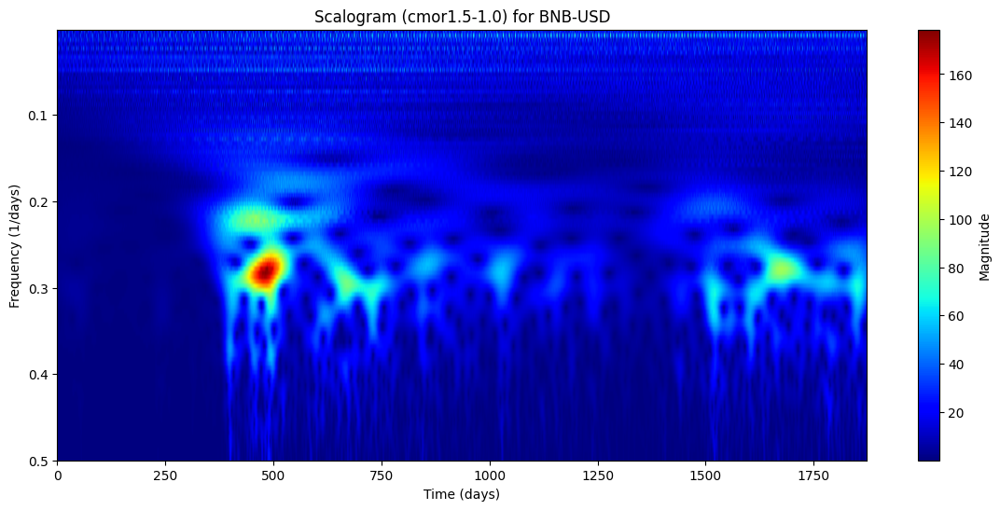

Анализ BNB-USD с вейвлетом morl...


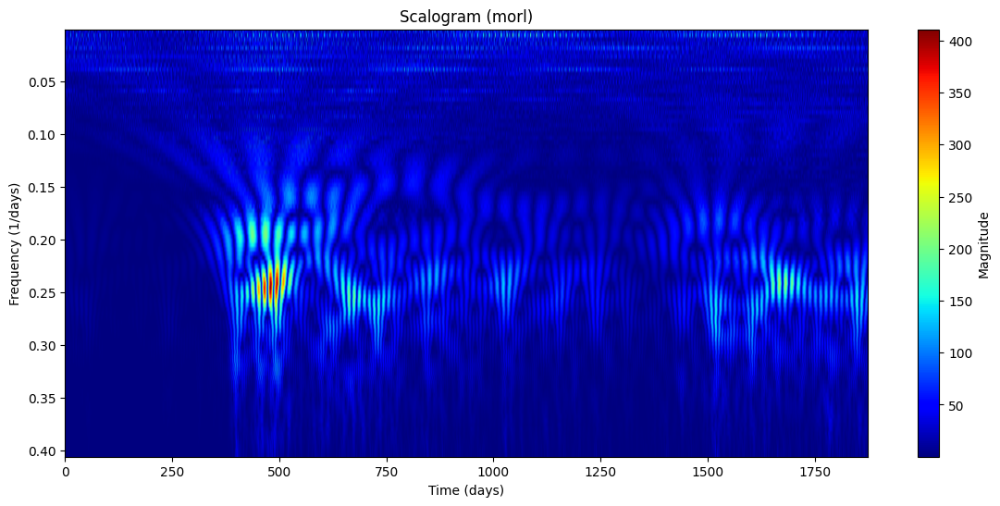

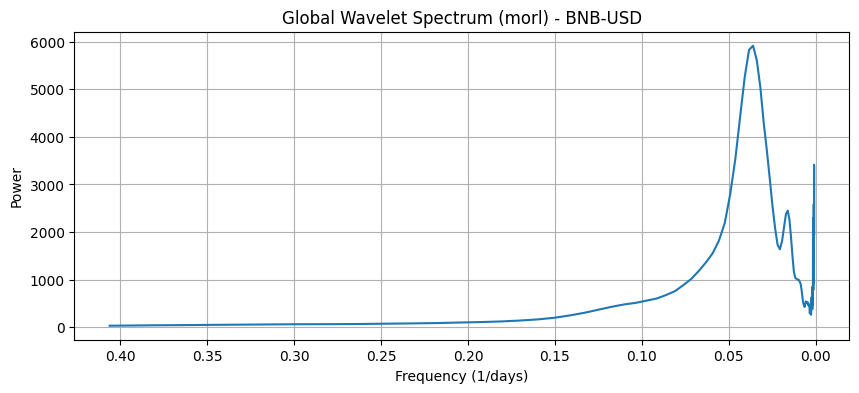

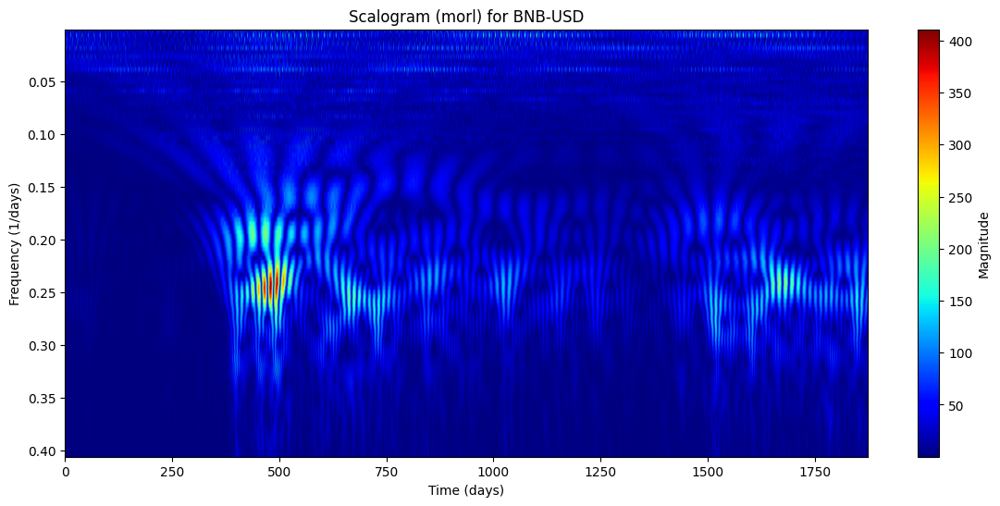

Анализ BNB-USD с вейвлетом gaus2...


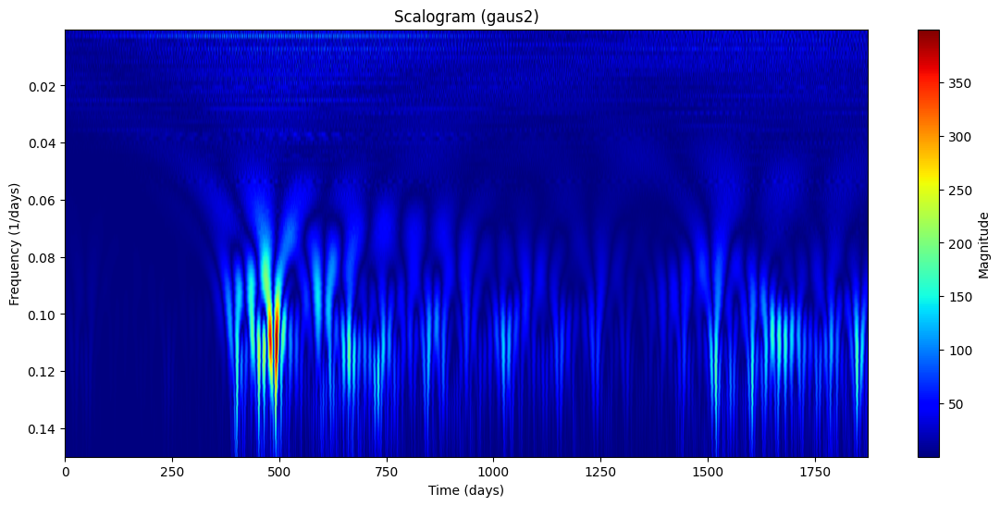

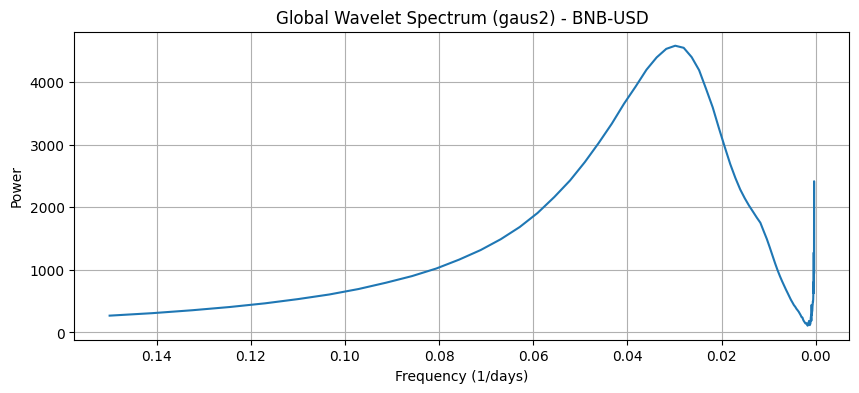

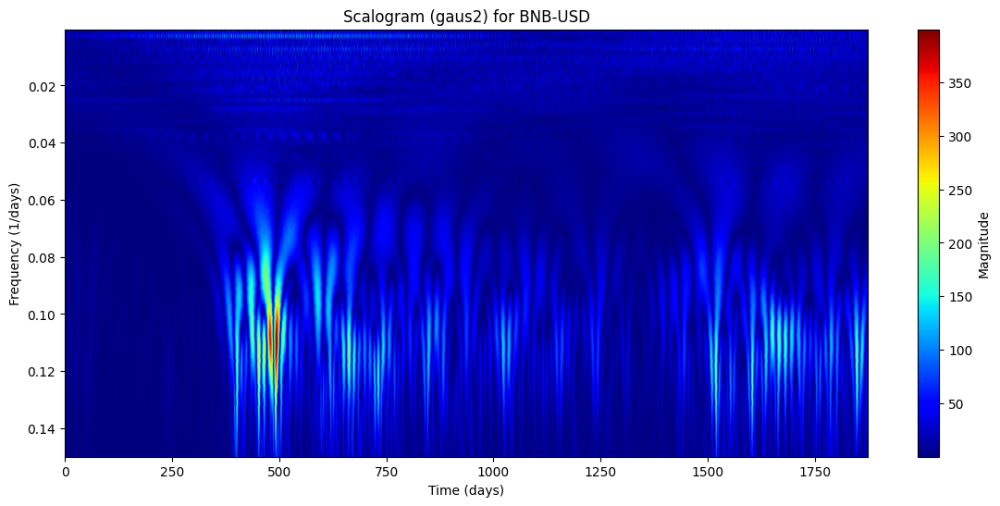

Анализ BNB-USD с вейвлетом shan1-1.5...


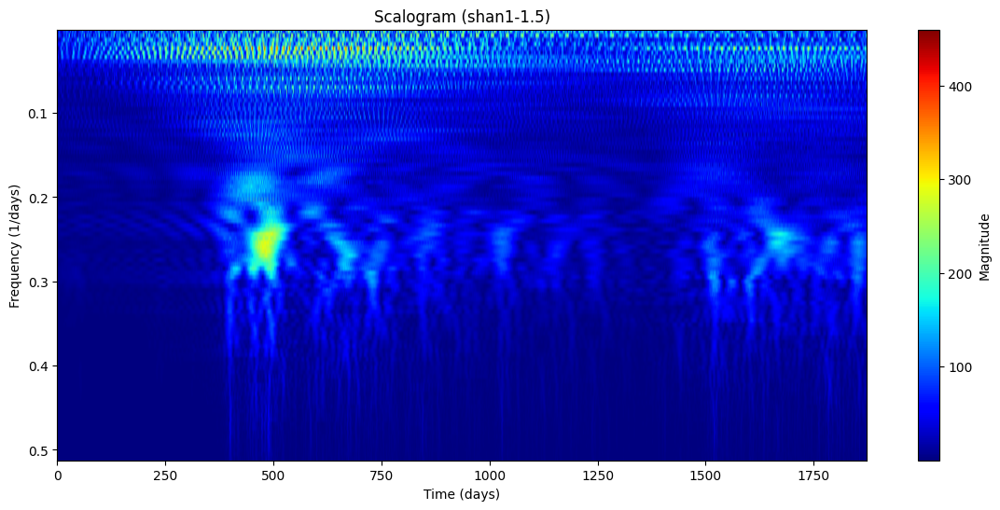

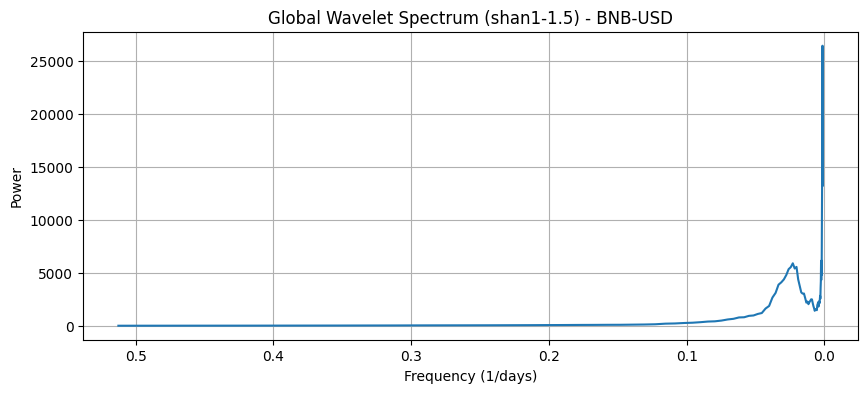

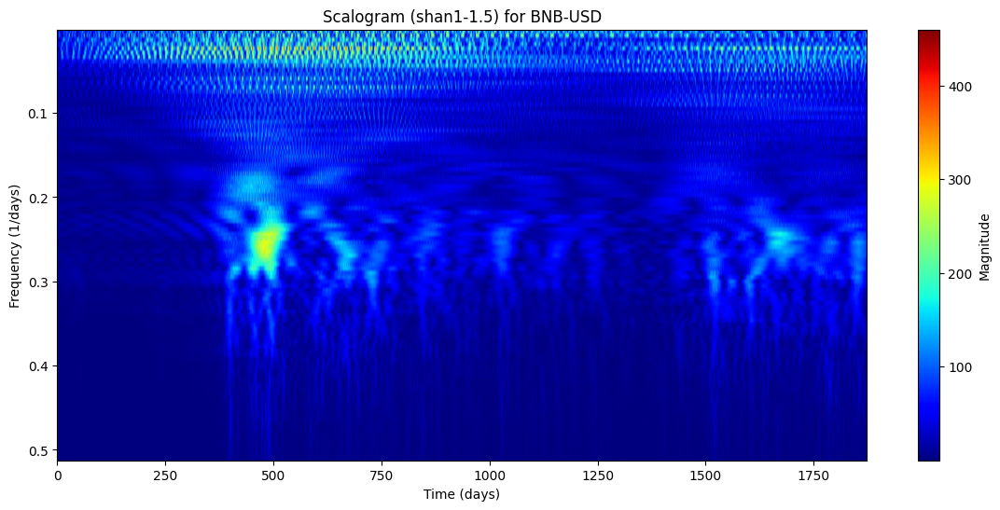

Анализ BNB-USD с вейвлетом cgau4...


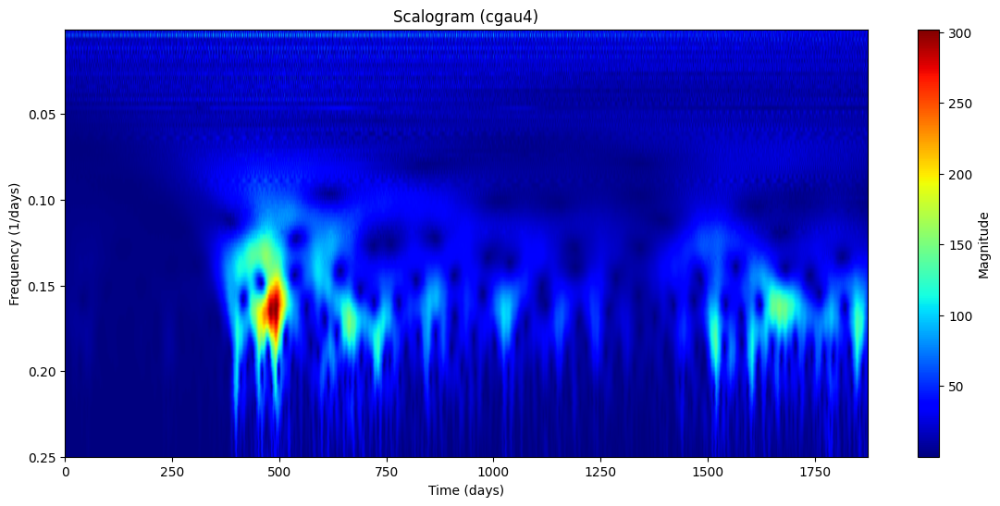

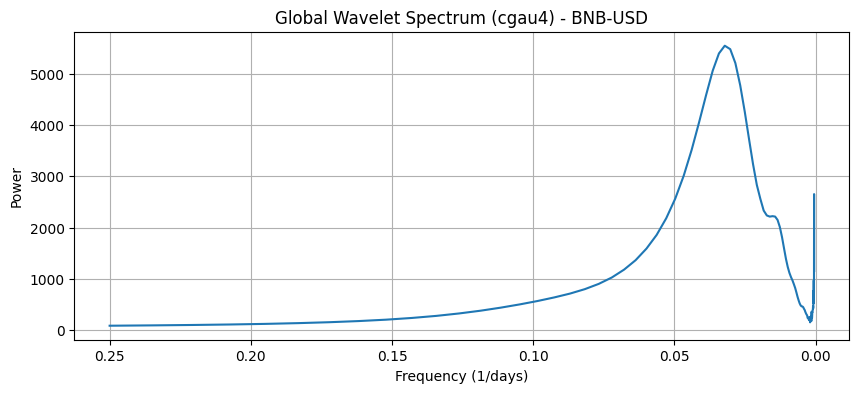

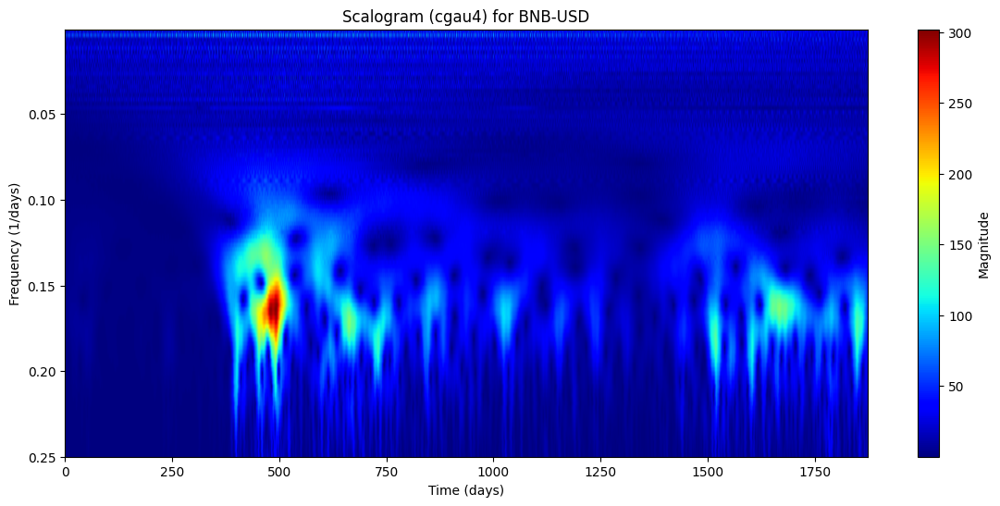

array([   73099.03374228,    82519.98860775,    91953.01027494,
         101637.20208281,   111020.40688952,   122542.15257435,
         135861.61764431,   154288.97246137,   173989.08215172,
         196857.49969301,   225298.1185141 ,   261029.04982549,
         302915.06748342,   346890.29027961,   382211.12865405,
         407950.28389956,   426258.95054913,   447994.00430336,
         485992.93584842,   546682.63717876,   649164.86957109,
         791121.46965959,   959905.40818995,  1129526.10285879,
        1261609.58441284,  1385032.82184013,  1528347.43360504,
        1740730.79545934,  1988936.09690198,  2277107.90750527,
        2573589.29034899,  2850136.02719057,  3112111.33838687,
        3368225.64122163,  3730463.77255386,  4327285.10027779,
        5265615.90848936,  6568788.30562866,  8178772.59049955,
       10239397.79699937, 12463504.6488629 , 14703766.14475352,
       16720906.06557153, 17868986.49482042, 17563346.3611085 ,
       15704295.89251839, 13103731.41850

In [9]:
def visualize_global_wavelet_spectrum(coef, frequencies, ticker, wavelet_name):
    """Визуализирует средний вейвлет-спектр."""
    global_ws = (abs(coef) ** 2).mean(axis=1)  # Усреднение по времени (axis=1)

    plt.figure(figsize=(10, 4))
    plt.plot(frequencies, global_ws)
    plt.title(f'Global Wavelet Spectrum ({wavelet_name}) - {ticker}')
    plt.xlabel('Frequency (1/days)')
    plt.ylabel('Power')  # Или Amplitude^2
    plt.gca().invert_xaxis() # Чтобы частота уменьшалась слева направо
    plt.grid(True)
    plt.show()

def visualize_wavelet(wavelet_name):
    """Отрисовывает сам вейвлет."""
    try: # Added try-except block
        base_wavelet_name = wavelet_name.split('-')[0] # Extract base name
        wavelet = pywt.Wavelet(base_wavelet_name) # Use base name here
        plt.figure(figsize=(14, 3))
        if wavelet.complex_cwt:
            phi, x = wavelet.wavefun(level=10)
            plt.plot(x, np.real(phi), label='Real')
            plt.plot(x, np.imag(phi), label='Imaginary')
            plt.title(f'Wavelet: {wavelet_name}')
            plt.legend()
        else:
            try:  # Обработка исключения, если у вейвлета нет psi
                 phi, psi, x = wavelet.wavefun(level=10)
                 plt.plot(x, psi)
                 plt.title(f'Wavelet: {wavelet_name}')
            except ValueError:
                 print(f"У вейвлета {wavelet_name} нет psi")

        plt.show()
    except ValueError as e: # Catch ValueError in visualize_wavelet
        print(f"Warning: Could not visualize wavelet '{wavelet_name}': {e}")

def visualize_cwt(residuals, coef, frequencies, wavelet_name, ticker):
    """Визуализирует скалограмму CWT."""
    plt.figure(figsize=(14, 6))
    plt.imshow(np.abs(coef), extent=[0, len(residuals), frequencies[-1], frequencies[0]], aspect='auto',
               cmap='jet', origin='upper')
    plt.colorbar(label='Magnitude')
    plt.title(f'Scalogram ({wavelet_name}) for {ticker}')
    plt.ylabel('Frequency (1/days)')
    plt.xlabel('Time (days)')
    plt.gca().invert_yaxis()
    plt.show()


def analyze_all_cryptos(decomposed_data, wavelet_names):
    """
    Выполняет CWT для всех криптовалют и выбранных вейвлетов.

    Args:
        decomposed_data (dict): Результат decompose_timeseries.
        wavelet_names (list): Список имён вейвлетов для анализа.

    Returns:
        dict: Словарь с результатами CWT для каждой криптовалюты и каждого вейвлета.
    """

    results = {}
    for ticker, data in decomposed_data.items():
        if data is not None:
            results[ticker] = {}
            residuals = data['residuals']
            for wavelet_name in wavelet_names:
                print(f"Анализ {ticker} с вейвлетом {wavelet_name}...")
                coef, frequencies = cwt_analysis(residuals, wavelet_name=wavelet_name)

                # Визуализация глобального вейвлет-спектра и добавление в results (moved inside the loop)
                global_ws = (abs(coef) ** 2).mean(axis=1)  # Усреднение по времени (axis=1)
                visualize_global_wavelet_spectrum(coef, frequencies, ticker, wavelet_name)
                results[ticker][wavelet_name] = {
                    'coef': coef,
                    'frequencies': frequencies,
                    'global_ws': global_ws # Добавляем global_ws в results
                }
                visualize_cwt(residuals, coef, frequencies, wavelet_name, ticker)  # Визуализация скалограммы
                visualize_wavelet(wavelet_name) #Визуализация вейвлета
    return results

# Пример использования:

# Список вейвлетов для анализа
wavelet_names = ['cmor1.5-1.0', 'morl', 'gaus2', 'shan1-1.5', 'cgau4']

# Выполняем CWT для всех криптовалют и вейвлетов
cwt_results = analyze_all_cryptos(decomposed_crypto_data, wavelet_names)

# Теперь в cwt_results хранятся результаты CWT.
#  Доступ к результатам:
cwt_results['BTC-USD']['cmor1.5-1.0']['coef']
cwt_results['BTC-USD']['cmor1.5-1.0']['frequencies']
cwt_results['BTC-USD']['cmor1.5-1.0']['global_ws'] # Доступ к global_ws

# (Дальнейший анализ: Feature Engineering и машинное обучение)

# **Обучение модели регрессора случайного леса с применением оптимизаций гиперпараметров.**

In [10]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

Mean Squared Error: 0.0010123919713863143


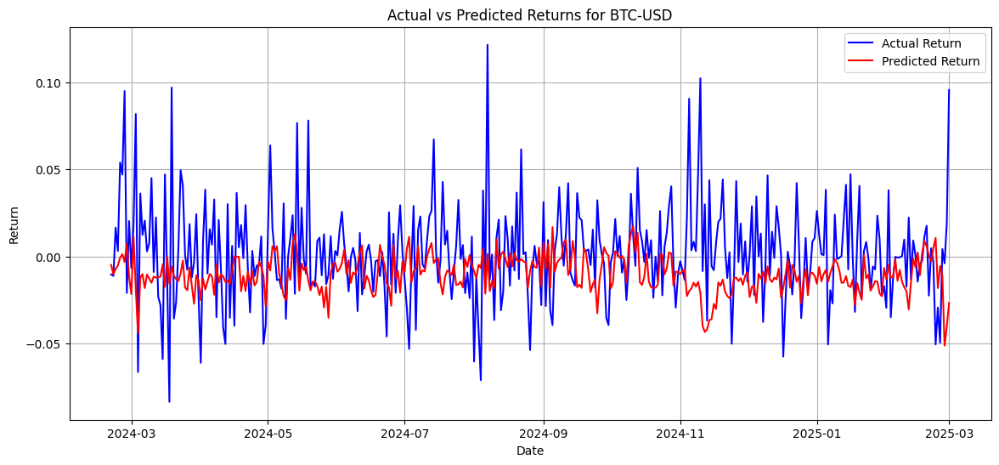

In [11]:
# Используем данные для BTC-USD
df = crypto_data['BTC-USD'].copy()
df.index = pd.to_datetime(df.index)

# Создаем новые признаки
df['Return'] = df[('Close', 'BTC-USD')].pct_change()  # процентная доходность
df['Log_Return'] = np.log(df[('Close', 'BTC-USD')]/df[('Close', 'BTC-USD')].shift(1))  # логарифмическая доходность
df['MA_5'] = df[('Close', 'BTC-USD')].rolling(window=5).mean()      # 5-дневное скользящее среднее
df['MA_10'] = df[('Close', 'BTC-USD')].rolling(window=10).mean()    # 10-дневное скользящее среднее
df['STD_5'] = df[('Close', 'BTC-USD')].rolling(window=5).std()      # 5-дневное стандартное отклонение
df['STD_10'] = df[('Close', 'BTC-USD')].rolling(window=10).std()    # 10-дневное стандартное отклонение

# Лаговые показатели доходности
df['Lag_1'] = df['Return'].shift(1)
df['Lag_2'] = df['Return'].shift(2)
df['Lag_3'] = df['Return'].shift(3)

# Удаляем строки с пропущенными значениями
df.dropna(inplace=True)

# Целевая переменная: доходность следующего дня
df['Target'] = df['Return'].shift(-1)
df.dropna(inplace=True)

# Выбираем признаки и цель
feature_cols = ['Return', 'Log_Return', 'MA_5', 'MA_10', 'STD_5', 'STD_10', 'Lag_1', 'Lag_2', 'Lag_3']
X = df[feature_cols]
y = df['Target']

# Разбиваем данные на обучающую и тестовую выборки (без перемешивания для временных рядов)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Обучение модели Random Forest
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Прогнозирование на тестовой выборке
predictions = model.predict(X_test)

# Оценка модели с использованием среднеквадратичной ошибки (MSE)
mse = mean_squared_error(y_test, predictions)
print(f"Mean Squared Error: {mse}")

# Визуализация фактических и прогнозируемых доходностей
plt.figure(figsize=(14,6))
plt.plot(y_test.index, y_test, label='Actual Return', color='blue')
plt.plot(y_test.index, predictions, label='Predicted Return', color='red')
plt.title('Actual vs Predicted Returns for BTC-USD')
plt.xlabel('Date')
plt.ylabel('Return')
plt.legend()
plt.grid(True)
plt.show()


[*********************100%***********************]  1 of 1 completed

Fitting 5 folds for each of 36 candidates, totalling 180 fits


Лучшие параметры: {'max_depth': 3, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'n_estimators': 100}
Наилучшее (отрицательное) MSE на кросс-валидации: -0.0011124422828487092
Test MSE: 0.0008201871444094508
Лучшая модель сохранена в файл 'best_rf_model.joblib'.


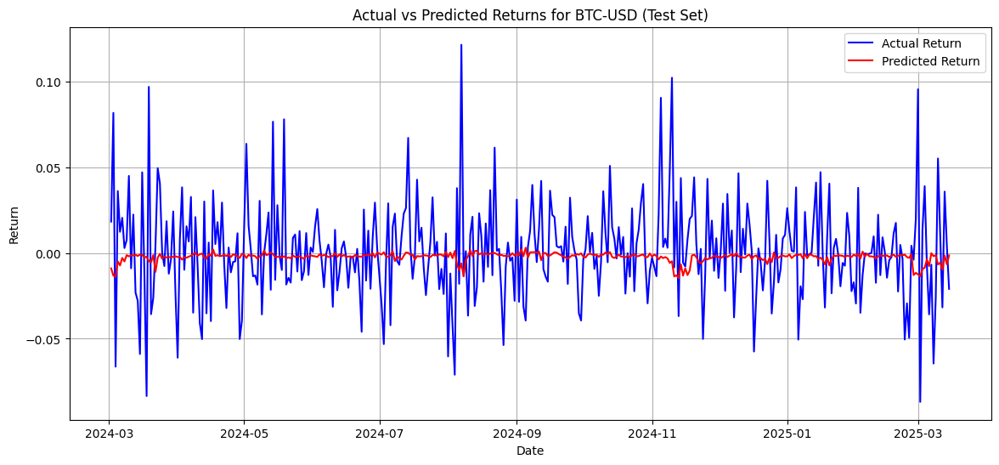

In [12]:
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV

import joblib

# 1. Загружаем данные (пример для BTC-USD)
ticker = 'BTC-USD'
start_date = '2020-01-01'
end_date = datetime.today().strftime('%Y-%m-%d')

df = yf.download(ticker, start=start_date, end=end_date)
df.index = pd.to_datetime(df.index)

# 2. Создаем признаки
df['Return'] = df['Close'].pct_change()  # процентная доходность
df['Log_Return'] = np.log(df['Close'] / df['Close'].shift(1))  # логарифмическая доходность
df['MA_5'] = df['Close'].rolling(window=5).mean()      # 5-дневное скользящее среднее
df['MA_10'] = df['Close'].rolling(window=10).mean()    # 10-дневное скользящее среднее
df['STD_5'] = df['Close'].rolling(window=5).std()      # 5-дневное стандартное отклонение
df['STD_10'] = df['Close'].rolling(window=10).std()    # 10-дневное стандартное отклонение

# Лаговые показатели доходности
df['Lag_1'] = df['Return'].shift(1)
df['Lag_2'] = df['Return'].shift(2)
df['Lag_3'] = df['Return'].shift(3)

df.dropna(inplace=True)

# 3. Целевая переменная: доходность на следующий день
df['Target'] = df['Return'].shift(-1)
df.dropna(inplace=True)

# 4. Формируем X и y
feature_cols = ['Return', 'Log_Return', 'MA_5', 'MA_10', 'STD_5', 'STD_10', 'Lag_1', 'Lag_2', 'Lag_3']
X = df[feature_cols]
y = df['Target']

# Делим на train/test (без shuffle)
train_size = int(len(X)*0.8)
X_train, X_test = X.iloc[:train_size], X.iloc[train_size:]
y_train, y_test = y.iloc[:train_size], y.iloc[train_size:]

# 5. Задаём кросс-валидатор для временных рядов
tscv = TimeSeriesSplit(n_splits=5)

# 6. Настраиваем Grid Search по гиперпараметрам RandomForestRegressor
param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, 10],
    'min_samples_leaf': [1, 2, 5],
    'max_features': ['sqrt', 'log2']
}

model = RandomForestRegressor(random_state=42)

grid_search = GridSearchCV(
    estimator=model,
    param_grid=param_grid,
    scoring='neg_mean_squared_error',  # метрика MSE (будет браться со знаком минус)
    cv=tscv,                           # кросс-валидатор для временных рядов
    n_jobs=-1,                         # использовать все доступные ядра
    verbose=1
)

# 7. Обучаем Grid Search на train-данных
grid_search.fit(X_train, y_train)

# 8. Смотрим лучшие параметры и итоговый скор
best_model = grid_search.best_estimator_
print("Лучшие параметры:", grid_search.best_params_)
print("Наилучшее (отрицательное) MSE на кросс-валидации:", grid_search.best_score_)

# 9. Оцениваем лучшую модель на тестовой выборке
y_pred = best_model.predict(X_test)
mse_test = mean_squared_error(y_test, y_pred)
print(f"Test MSE: {mse_test}")

# 10. Сохраняем лучшую модель
joblib.dump(best_model, 'best_rf_model.joblib')
print("Лучшая модель сохранена в файл 'best_rf_model.joblib'.")

# 11. Визуализация фактических и прогнозных доходностей
plt.figure(figsize=(14, 6))
plt.plot(y_test.index, y_test, label='Actual Return', color='blue')
plt.plot(y_test.index, y_pred, label='Predicted Return', color='red')
plt.title(f'Actual vs Predicted Returns for {ticker} (Test Set)')
plt.xlabel('Date')
plt.ylabel('Return')
plt.legend()
plt.grid(True)
plt.show()

# **Глубокое обучение нейронной сети.**

In [13]:
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [14]:
# 1. Загрузка данных (если crypto_data не загружены ранее)
tickers = ['BTC-USD'] # Оставим только BTC-USD для начала
start_date = '2020-01-01'
end_date = datetime.today().strftime('%Y-%m-%d')
crypto_data = load_and_clean_data(tickers, start_date, end_date)

# Используем данные для BTC-USD
df = crypto_data['BTC-USD'].copy()
df.index = pd.to_datetime(df.index)

# 2. Создание признаков (как и раньше)
df['Return'] = df[('Close', 'BTC-USD')].pct_change()
df['Log_Return'] = np.log(df[('Close', 'BTC-USD')]/df[('Close', 'BTC-USD')].shift(1))
df['MA_5'] = df[('Close', 'BTC-USD')].rolling(window=5).mean()
df['MA_10'] = df[('Close', 'BTC-USD')].rolling(window=10).mean()
df['STD_5'] = df[('Close', 'BTC-USD')].rolling(window=5).std()
df['STD_10'] = df[('Close', 'BTC-USD')].rolling(window=10).std()
df['Lag_1'] = df['Return'].shift(1)
df['Lag_2'] = df['Return'].shift(2)
df['Lag_3'] = df['Return'].shift(3)

df.dropna(inplace=True)

# Целевая переменная
df['Target'] = df['Return'].shift(-1)
df.dropna(inplace=True)

# Выбираем признаки и цель
feature_cols = ['Return', 'Log_Return', 'MA_5', 'MA_10', 'STD_5', 'STD_10', 'Lag_1', 'Lag_2', 'Lag_3']
X = df[feature_cols]
y = df['Target']

# Разбиваем на обучающую и тестовую выборки (без перемешивания)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# 3. Нормализация данных (StandardScaler)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train) # fit_transform на обучающих данных
X_test_scaled = scaler.transform(X_test)     # только transform на тестовых данных (используем параметры масштабирования с обучающих)

print("Размерность X_train_scaled:", X_train_scaled.shape)
print("Размерность X_test_scaled:", X_test_scaled.shape)
print("Размерность y_train:", y_train.shape)
print("Размерность y_test:", y_test.shape)

[*********************100%***********************]  1 of 1 completed

Type of df for BTC-USD: <class 'pandas.core.frame.DataFrame'>
df.head() for BTC-USD:
Price             Close         High          Low         Open       Volume
Ticker          BTC-USD      BTC-USD      BTC-USD      BTC-USD      BTC-USD
Date                                                                       
2020-01-01  7200.174316  7254.330566  7174.944336  7194.892090  18565664997
2020-01-02  6985.470215  7212.155273  6935.270020  7202.551270  20802083465
2020-01-03  7344.884277  7413.715332  6914.996094  6984.428711  28111481032
2020-01-04  7410.656738  7427.385742  7309.514160  7345.375488  18444271275
2020-01-05  7411.317383  7544.497070  7400.535645  7410.451660  19725074095
df.columns for BTC-USD: MultiIndex([( 'Close', 'BTC-USD'),
            (  'High', 'BTC-USD'),
            (   'Low', 'BTC-USD'),
            (  'Open', 'BTC-USD'),
            ('Volume', 'BTC-USD')],
           names=['Price', 'Ticker'])
Trying df[('Open', 'BTC-USD')].iloc[0] for BTC-USD: 7194.89208984375



<ipython-input-4-1238d1038dfb>:58: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True) # Заполнение пропусков предыдущим значением


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Test Mean Squared Error: 0.0029
Test Mean Absolute Error: 0.0425
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


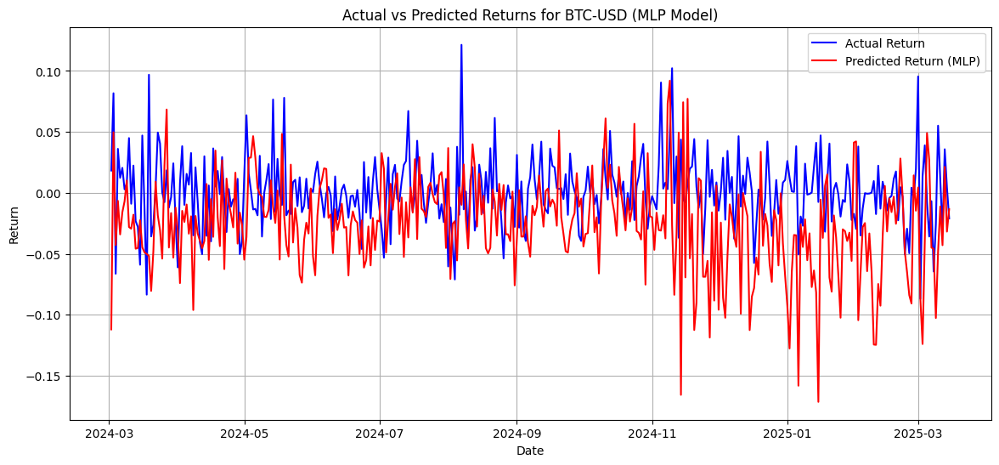

In [15]:
# 1. Создание модели MLP
model_mlp = keras.Sequential([
    layers.Dense(64, activation='relu', input_shape=[X_train_scaled.shape[1]]), # Входной слой + скрытый слой (64 нейрона, ReLU)
    layers.Dense(32, activation='relu'),                                        # Еще один скрытый слой (32 нейрона, ReLU)
    layers.Dense(1)                                                             # Выходной слой (1 нейрон, линейная активация для регрессии)
])

# 2. Компиляция модели
model_mlp.compile(optimizer='adam',     # Оптимизатор Adam
              loss='mse',               # Функция потерь: Mean Squared Error (MSE) для регрессии
              metrics=['mae', 'mse'])   # Метрики для оценки: Mean Absolute Error (MAE), Mean Squared Error (MSE)

# 3. Обучение модели
history = model_mlp.fit(
    X_train_scaled, y_train,  #
    epochs=50,                # Количество эпох
    batch_size=32,            # Размер батча
    validation_split=0.2,     # 20% обучающих данных для валидации
    verbose=0                 # Убираем вывод обучения для краткости (можно поставить 1 для просмотра прогресса)
)

# 4. Оценка модели на тестовых данных
loss, mae, mse = model_mlp.evaluate(X_test_scaled, y_test, verbose=0)
print(f"Test Mean Squared Error: {mse:.4f}")
print(f"Test Mean Absolute Error: {mae:.4f}")

# 5. Прогнозирование на тестовых данных
predictions_mlp = model_mlp.predict(X_test_scaled).flatten() # flatten() чтобы привести к одномерному массиву

# 6. Визуализация результатов
plt.figure(figsize=(14,6))
plt.plot(y_test.index, y_test, label='Actual Return', color='blue')
plt.plot(y_test.index, predictions_mlp, label='Predicted Return (MLP)', color='red')
plt.title('Actual vs Predicted Returns for BTC-USD (MLP Model)')
plt.xlabel('Date')
plt.ylabel('Return')
plt.legend()
plt.grid(True)
plt.show()